<img align="left" src = https://project.lsst.org/sites/default/files/Rubin-O-Logo_0.png width=250 style="padding: 10px"> 
<br>
<b>HSC Cosmos Analysis Notebook</b> <br>
Contact author: Erin Howard<br>
Last verified to run: December 5, 2022<br>
LSST Science Piplines version: w_2022_46<br>
Container Size: Large <br>

# DM-35285: ApPipeWithFakes on HSC COSMOS, November 2022

New baseline run, still using "new diffim" (before the big refactor).

* Used weekly `w_2022_46` with default convolution mode
* Working directory on USDF with bps logs, pipelines, etc. is `/sdf/group/rubin/user/elhoward/repo-main-logs/DM-35285`
* Templates are in `u/mrawls/DM-34711/templates`
* Final processing of HSC COSMOS is in `u/elhoward/DM-35285/hsc-output-collection`
* Postgres schema is `elhoward_dm35285_hsc_appipewithfakes`

For ApPipeWithFakes.yaml:
```
inCollection: u/mrawls/DM-34711/templates,HSC/raw/RC2/9813,HSC/calib,HSC/masks,refcats,skymaps
dataQuery: "instrument='HSC' AND skymap='hsc_rings_v1' AND band IN ('g', 'r', 'i', 'z', 'y')"
```

## Table of Contents

1. Loading DiaObjects and DiaSources
2. DiaObject and DiaSources analysis
3. Comparisons to previous processing run
4. Separating the fake sources from the real sources
5. Fakes completeness analysis
6. Calexp and PSF analysis
7. SNR distributions

In [1]:
%matplotlib widget

import numpy as np
import matplotlib.pyplot as plt
import importlib
import pandas as pd
import astropy.units as u
import lsst.afw.display as afwDisplay
import lsst.geom

import lsst.daf.butler as dafButler
from lsst.analysis.ap import legacyApdbUtils as utils
from lsst.analysis.ap import legacyPlotUtils as plac

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

importlib.reload(utils)

Overriding default configuration file with /opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-5.0.0/Linux64/dustmaps_cachedata/g41a3ec361e+62d12e78cb/config/.dustmapsrc


<module 'lsst.analysis.ap.legacyApdbUtils' from '/sdf/data/rubin/u/elhoward/repos/analysis_ap/python/lsst/analysis/ap/legacyApdbUtils.py'>

## 1. Loading DiaObjects and DiaSources

In [2]:
repo = '/repo/main'
butler = dafButler.Butler(repo)
instrument = 'HSC'
skymap = 'hsc_rings_v1'

dbType='postgres'
dbName='lsst-devl'

collections = 'u/elhoward/DM-35285/hsc-output-collection'
schema = 'elhoward_dm35285_hsc_appipewithfakes'
month = 'November'
year = '2022'

collections_old = 'u/smart/DM-36389/hsc-output-collection'
schema_old = 'smart_dm36389_hsc_fakes_rerun'
month_old = 'October'
year_old = '2022'

collectionsList = [collections,collections_old]

In [3]:
objTable, srcTable, goodObj, goodSrc = utils.loadTables(repo,
                                                        dbName=dbName,
                                                        dbType=dbType,
                                                        instrument=instrument,
                                                        schema=schema)

In [4]:
flagTable, srcTableFlags, flagFilter, goodSrc, goodObj = utils.makeSrcTableFlags(srcTable, objTable,
                                                                                 instrument=instrument,
                                                                                 repo=repo)

In [5]:
objTable_old, srcTable_old, goodObj_old, goodSrc_old = utils.loadTables(repo,
                                                                        dbName=dbName,
                                                                        dbType=dbType,
                                                                        instrument=instrument,
                                                                        schema=schema_old)

In [6]:
flagTable_old, srcTableFlags_old, flagFilter_old, goodSrc_old, goodObj_old = utils.makeSrcTableFlags(srcTable_old, objTable_old,
                                                                                                     instrument=instrument,
                                                                                                     repo=repo)

## 2. DIA object and source visual analysis

Plots look reasonable and are consistent with last month's run. G band appears to have more DIA sources per visit than last month's run.

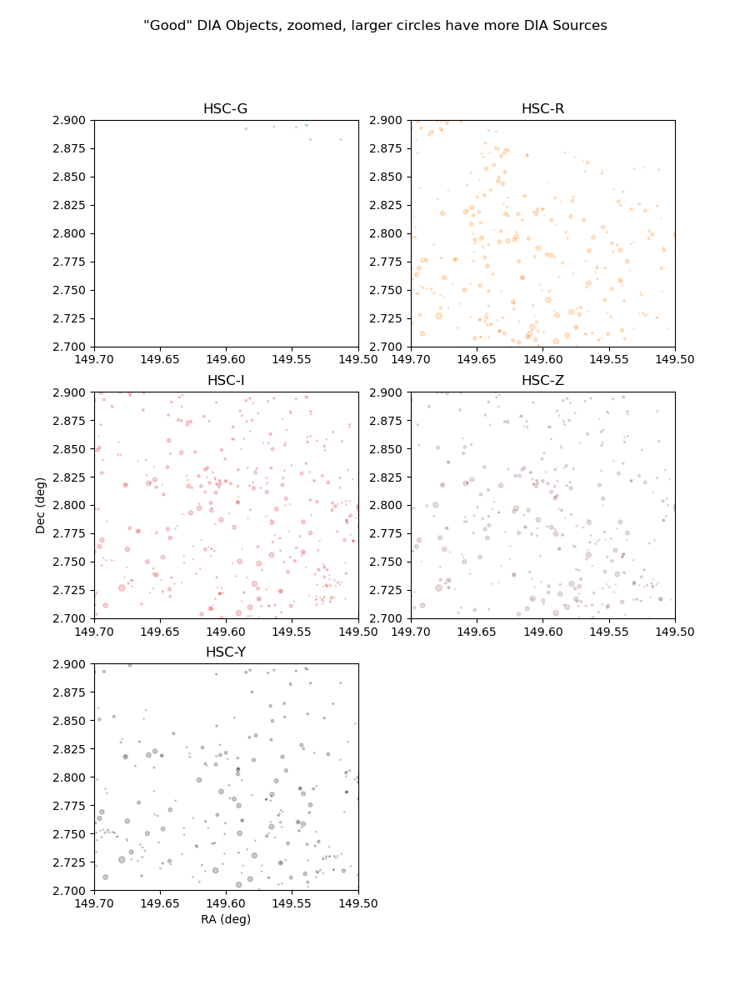

In [7]:
fig, axs = plt.subplots(3, 2, figsize=(9, 12))

fig.suptitle('"Good" DIA Objects, zoomed, larger circles have more DIA Sources')

nSrc = 2  # threshold for which DIA Objects to plot (only those with > nSrc constituent DIA Sources)

axG = axs[0, 0]
axR = axs[0, 1]
axI = axs[1, 0]
axZ = axs[1, 1]
axY = axs[2, 0]

ax0 = axs[2, 1]
ax0.axis('off')

axList = [axG, axR, axI, axZ, axY]

xlim = [149.7, 149.5]
ylim = [2.7, 2.9]
plt.setp(axs, xlim=xlim, ylim=ylim)

goodGFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['gPSFluxMean'] > 0)
goodRFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['rPSFluxMean'] > 0)
goodIFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['iPSFluxMean'] > 0)
goodZFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['zPSFluxMean'] > 0)
goodYFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['yPSFluxMean'] > 0)

goodFilterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

axY.set_xlabel('RA (deg)')
axI.set_ylabel('Dec (deg)')

axG.set_title('HSC-G')
axR.set_title('HSC-R')
axI.set_title('HSC-I')
axZ.set_title('HSC-Z')
axY.set_title('HSC-Y')

colorList = ['C2', 'C1', 'C3', 'C5', 'k']

for ax, goodFilter, color in zip(axList, goodFilterList, colorList):
    ax.scatter(goodObj.loc[goodFilter, 'ra'],
               goodObj.loc[goodFilter, 'decl'],
               s=goodObj.loc[goodFilter, 'nDiaSources'], c=color, marker='.', alpha=0.2)

Text(0.5, 1.0, 'HSC-Y')

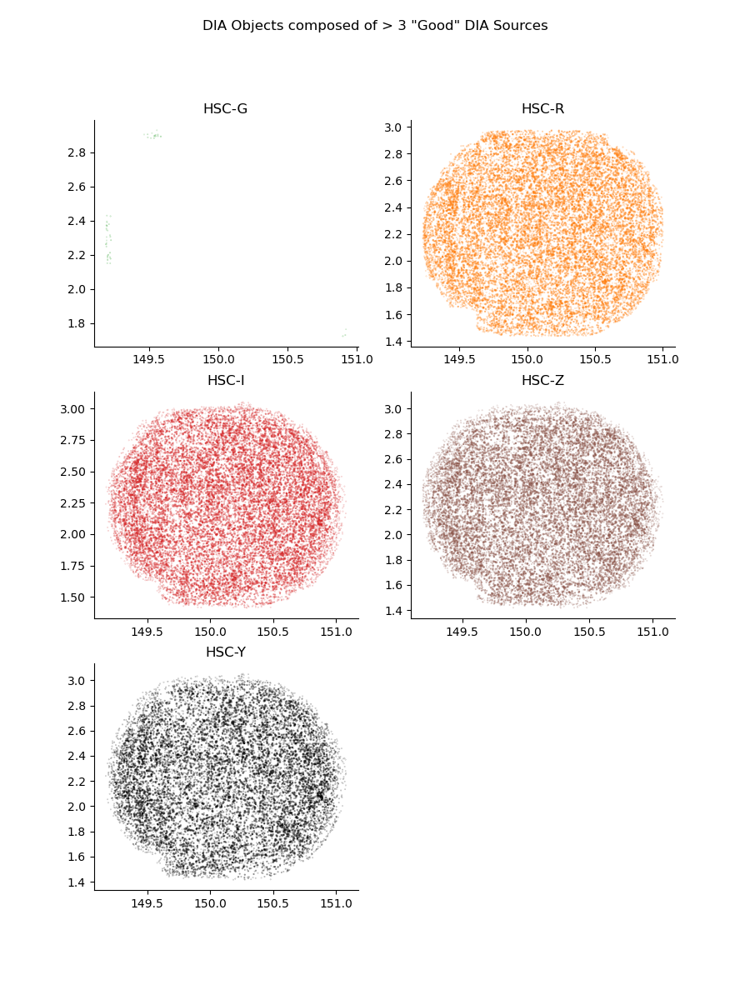

In [8]:
cutoff = 0  # only plot DIA Objects composed of cutoff or more DIA Sources

fig, axs = plt.subplots(3, 2, figsize=(9, 12))

axG = axs[0, 0]
axR = axs[0, 1]
axI = axs[1, 0]
axZ = axs[1, 1]
axY = axs[2, 0]
#axHits = axs[2, 1]

ax0 = axs[2, 1]
ax0.axis('off')

axList = [axG, axR, axI, axZ, axY]
colorList = ['C2', 'C1', 'C3', 'C5', 'k']

### DIA OBJECTS ###

nSrc = 3  # threshold for which DIA Objects to plot (only those with > nSrc constituent DIA Sources)
fig.suptitle(f'DIA Objects composed of > {nSrc} "Good" DIA Sources')

goodGFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['gPSFluxMean'] > 0)
goodRFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['rPSFluxMean'] > 0)
goodIFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['iPSFluxMean'] > 0)
goodZFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['zPSFluxMean'] > 0)
goodYFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['yPSFluxMean'] > 0)

filterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

for ax, filtered, color in zip(axList, filterList, colorList):
    ax.scatter(goodObj.loc[filtered, 'ra'], goodObj.loc[filtered, 'decl'], c=color, marker='.', alpha=0.4,
               s=goodObj.loc[(goodObj['nDiaSources'] > cutoff) & (filtered), 'nDiaSources']/20)

for ax in axList:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axG.set_title('HSC-G')
axR.set_title('HSC-R')
axI.set_title('HSC-I')
axZ.set_title('HSC-Z')
axY.set_title('HSC-Y')

Text(0.5, 1.0, 'HSC-Y')

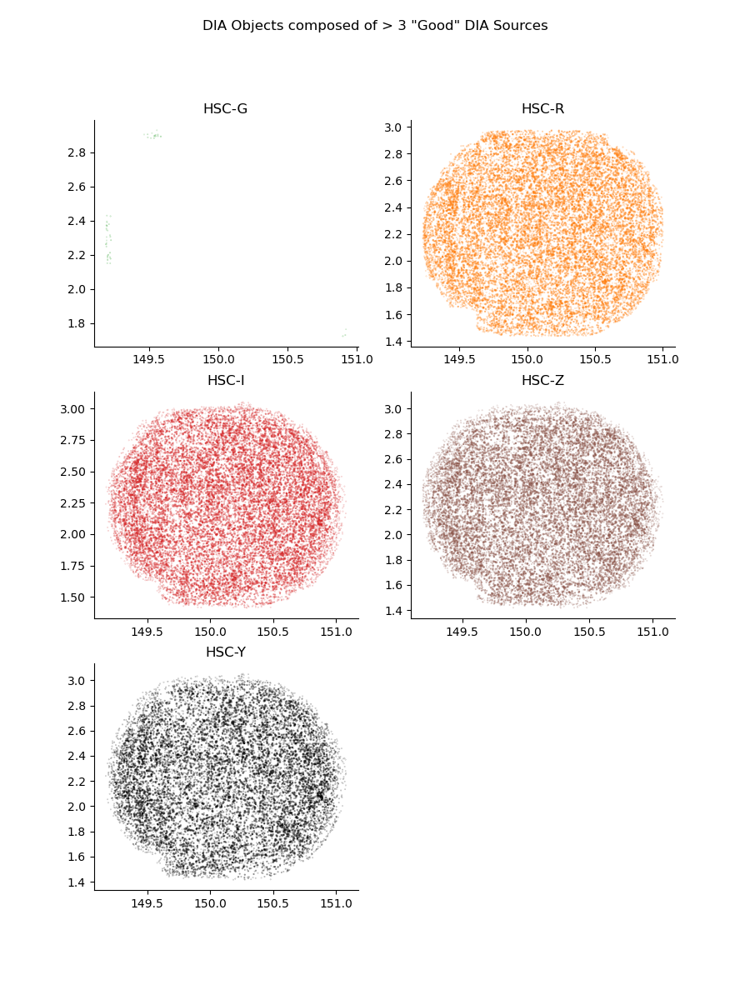

In [9]:
cutoff = 3  # only plot DIA Objects composed of cutoff or more DIA Sources

fig, axs = plt.subplots(3, 2, figsize=(9, 12))

axG = axs[0, 0]
axR = axs[0, 1]
axI = axs[1, 0]
axZ = axs[1, 1]
axY = axs[2, 0]
#axHits = axs[2, 1]

ax0 = axs[2, 1]
ax0.axis('off')

axList = [axG, axR, axI, axZ, axY]
colorList = ['C2', 'C1', 'C3', 'C5', 'k']

### DIA OBJECTS ###

nSrc = 3  # threshold for which DIA Objects to plot (only those with > nSrc constituent DIA Sources)
fig.suptitle(f'DIA Objects composed of > {nSrc} "Good" DIA Sources')

goodGFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['gPSFluxMean'] > 0)
goodRFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['rPSFluxMean'] > 0)
goodIFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['iPSFluxMean'] > 0)
goodZFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['zPSFluxMean'] > 0)
goodYFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['yPSFluxMean'] > 0)

filterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

for ax, filtered, color in zip(axList, filterList, colorList):
    ax.scatter(goodObj.loc[filtered, 'ra'], goodObj.loc[filtered, 'decl'], c=color, marker='.', alpha=0.4,
               s=goodObj.loc[(goodObj['nDiaSources'] > cutoff) & (filtered), 'nDiaSources']/20)

for ax in axList:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

axG.set_title('HSC-G')
axR.set_title('HSC-R')
axI.set_title('HSC-I')
axZ.set_title('HSC-Z')
axY.set_title('HSC-Y')

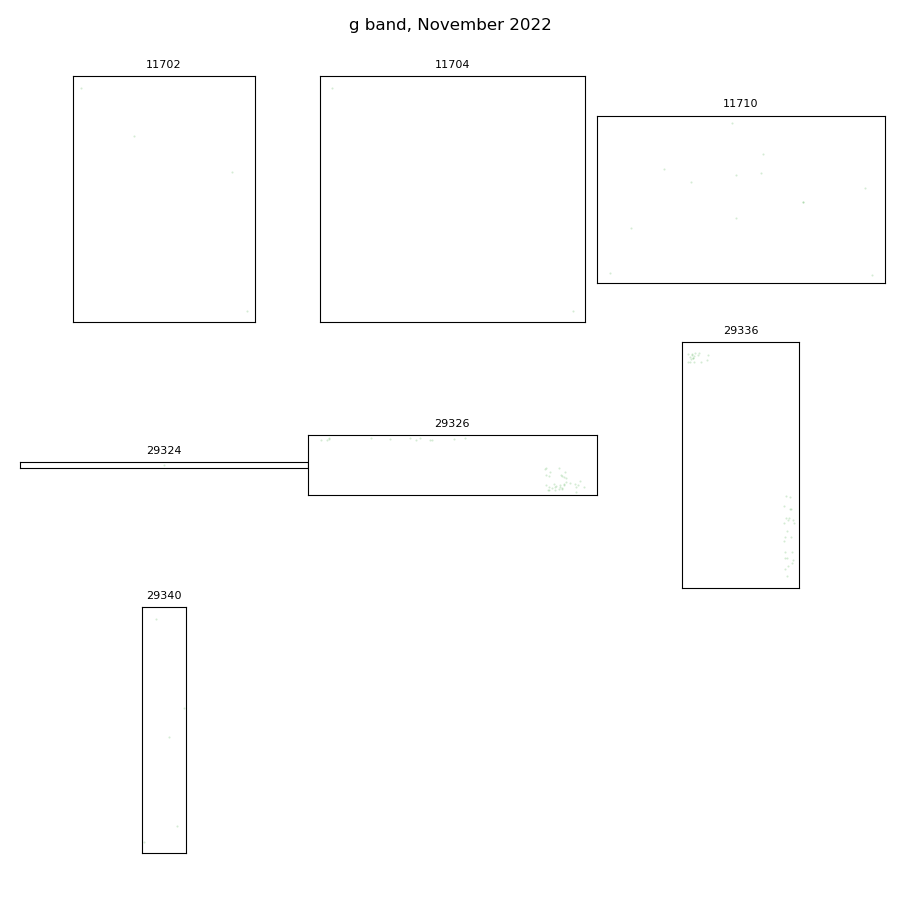

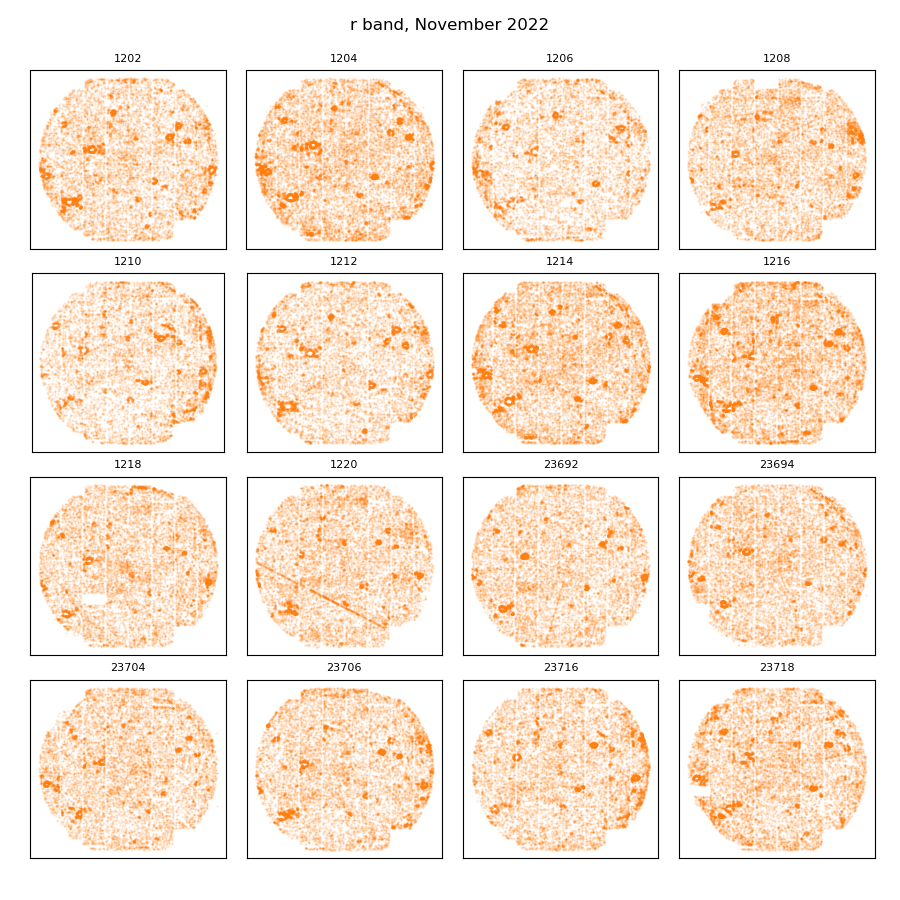

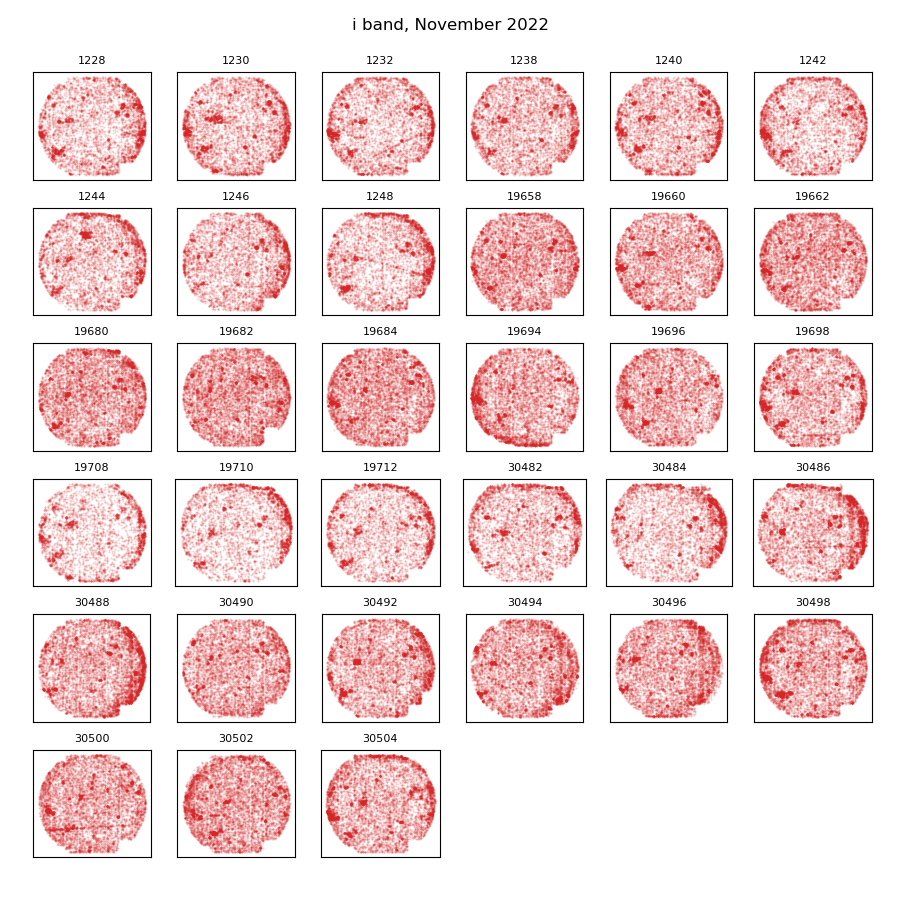

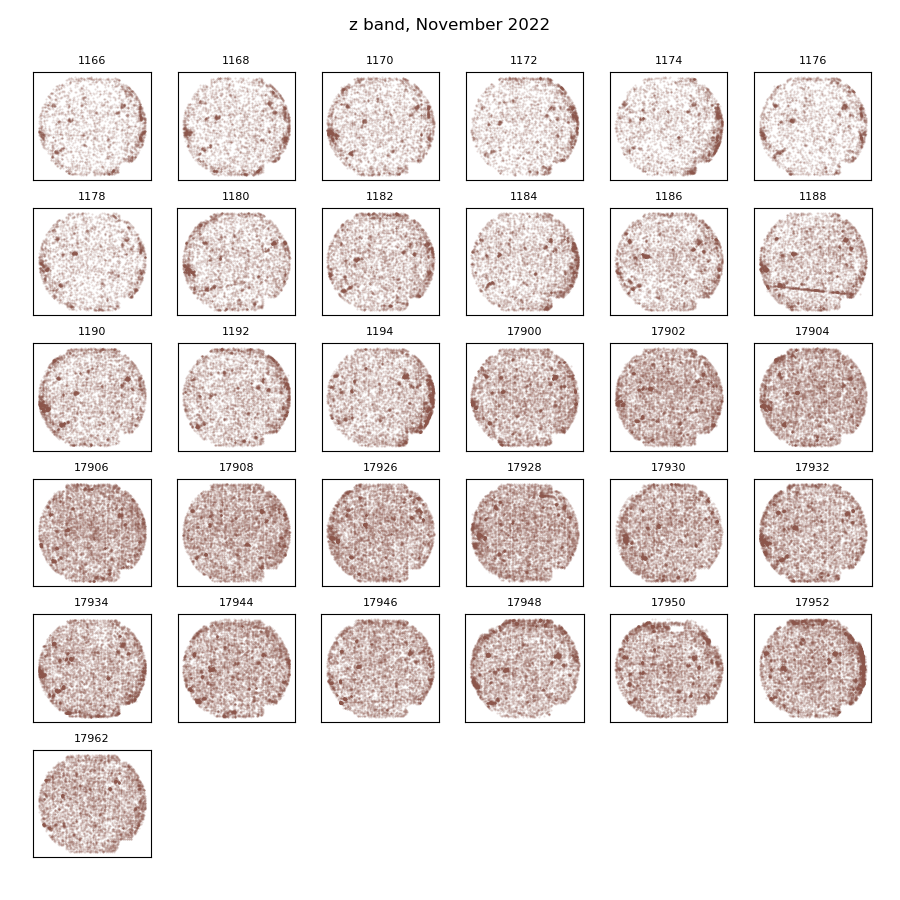

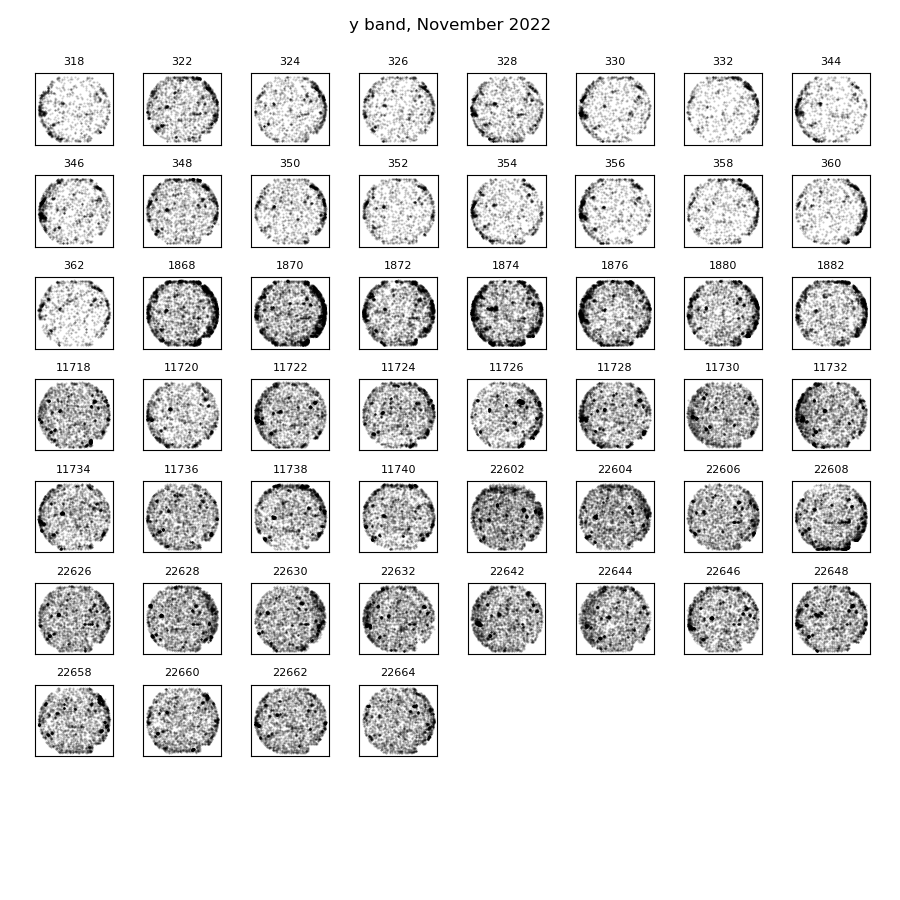

In [10]:
# Note: g band data per visit is sparse
bandList = ['g', 'r', 'i', 'z', 'y']
colorList = ['C2', 'C1', 'C3', 'C5', 'k']
size=1

for band, color in zip(bandList, colorList):
    plac.plotDiaSourcesOnSkyGrid(repo, goodSrc.loc[goodSrc['filterName'] == band], title=band+f' band, {month} {year}', color=color, size=size)

Text(0.5, 1.0, 'DIA Object and DIA Source counts, November 2022')

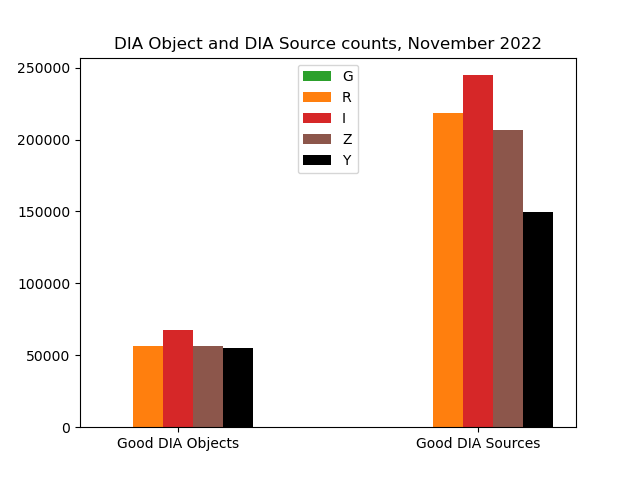

In [11]:
fig, ax = plt.subplots()
barLabels = ['Good DIA Objects', 'Good DIA Sources']
xbar = np.array([0, 1])
width = 0.2

goodObjG = goodObj.loc[goodObj['gPSFluxMean'] > 0]
goodObjR = goodObj.loc[goodObj['rPSFluxMean'] > 0]
goodObjI = goodObj.loc[goodObj['iPSFluxMean'] > 0]
goodObjZ = goodObj.loc[goodObj['zPSFluxMean'] > 0]
goodObjY = goodObj.loc[goodObj['yPSFluxMean'] > 0]

goodSrcG = goodSrc.loc[goodSrc['filterName'] == 'g']
goodSrcR = goodSrc.loc[goodSrc['filterName'] == 'r']
goodSrcI = goodSrc.loc[goodSrc['filterName'] == 'i']
goodSrcZ = goodSrc.loc[goodSrc['filterName'] == 'z']
goodSrcY = goodSrc.loc[goodSrc['filterName'] == 'y']

ax.bar(xbar - width, [len(goodObjG), len(goodSrcG)], width/2, label='G', color='C2')
ax.bar(xbar - width/2, [len(goodObjR), len(goodSrcR)], width/2, label='R', color='C1')
ax.bar(xbar, [len(goodObjI), len(goodSrcI)], width/2, label='I', color='C3')
ax.bar(xbar + width/2, [len(goodObjZ), len(goodSrcZ)], width/2, label='Z', color='C5')
ax.bar(xbar + width, [len(goodObjY), len(goodSrcY)], width/2, label='Y', color='k')

plt.legend(loc='upper center')
ax.set_xticks([0, 1])
labels = ax.set_xticklabels(barLabels)
plt.title(f'DIA Object and DIA Source counts, {month} {year}')

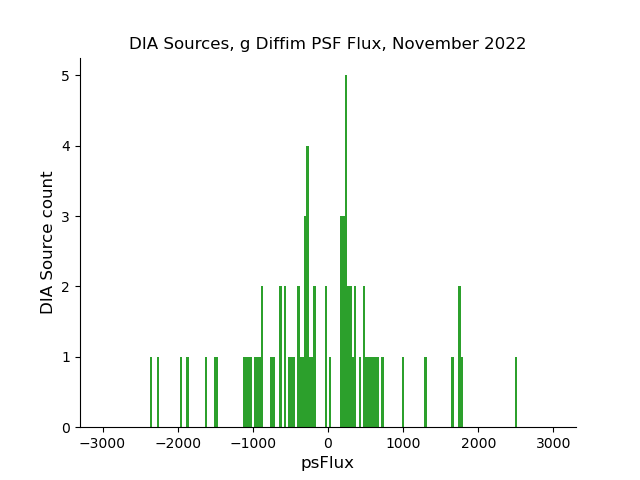

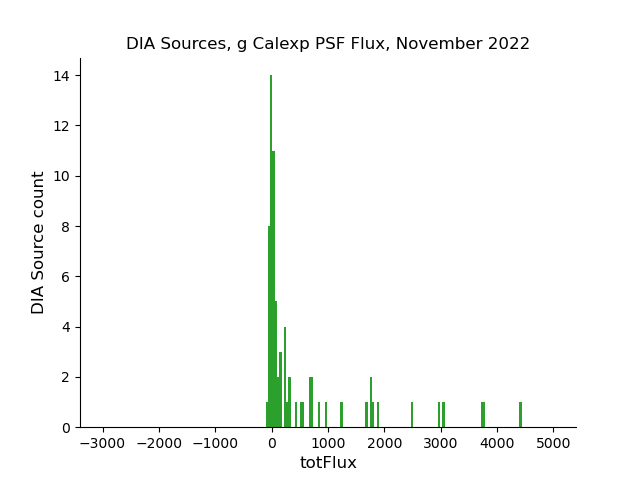

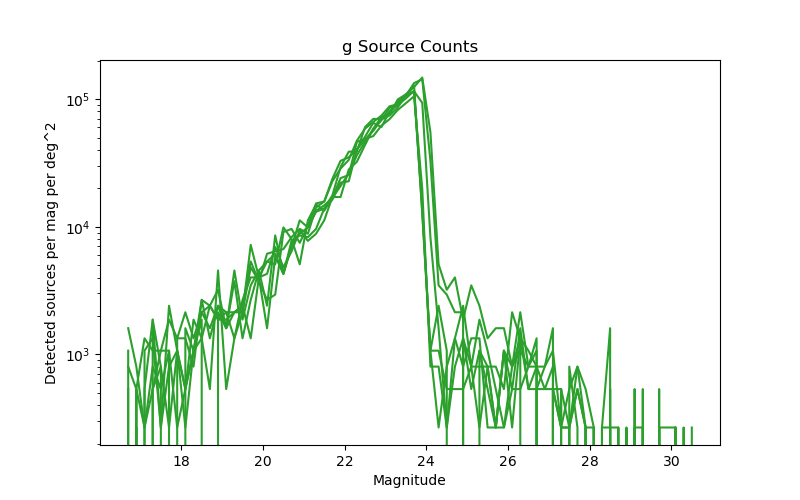

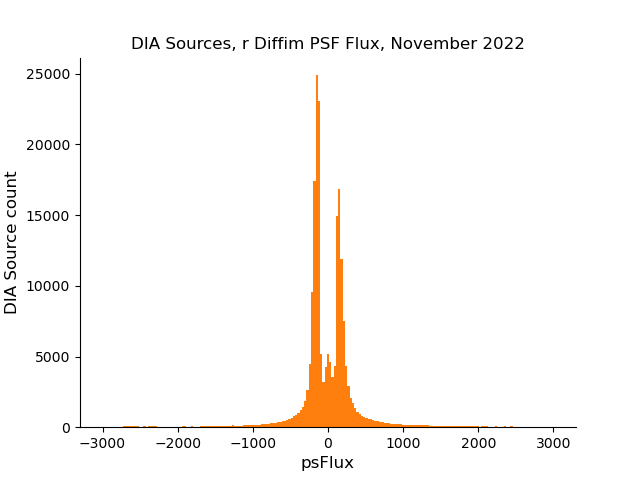

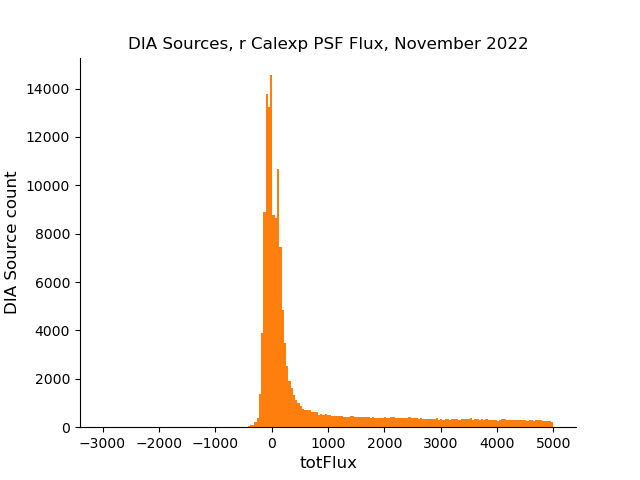

...

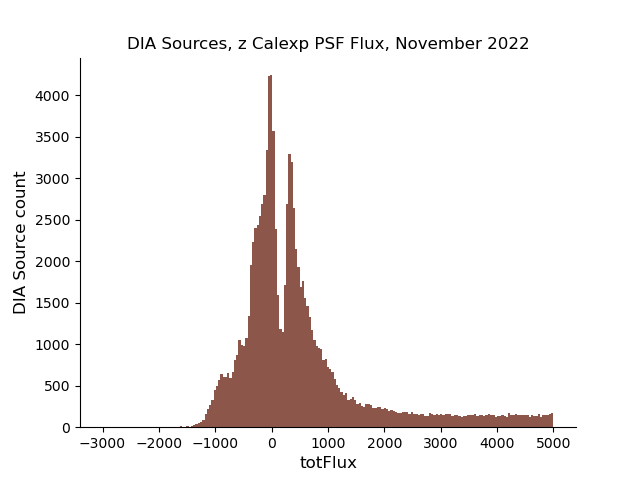

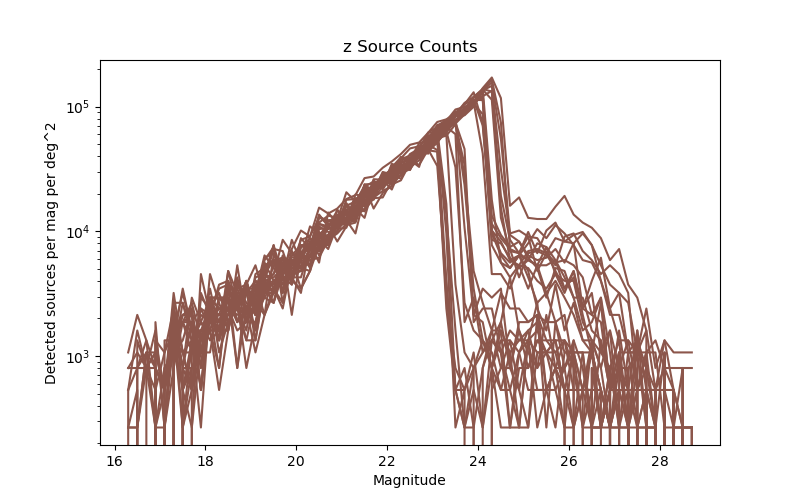

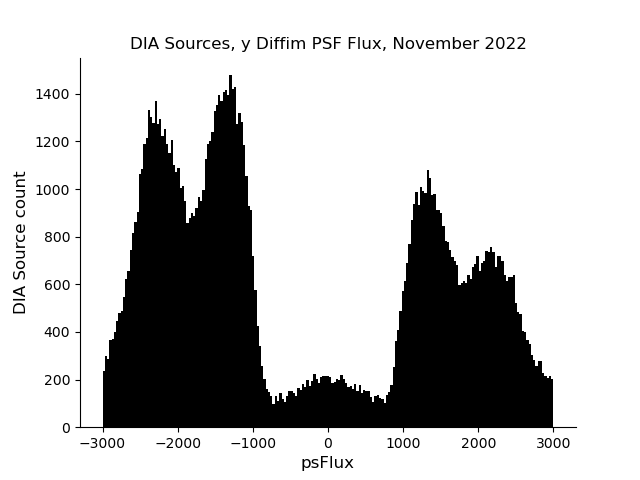

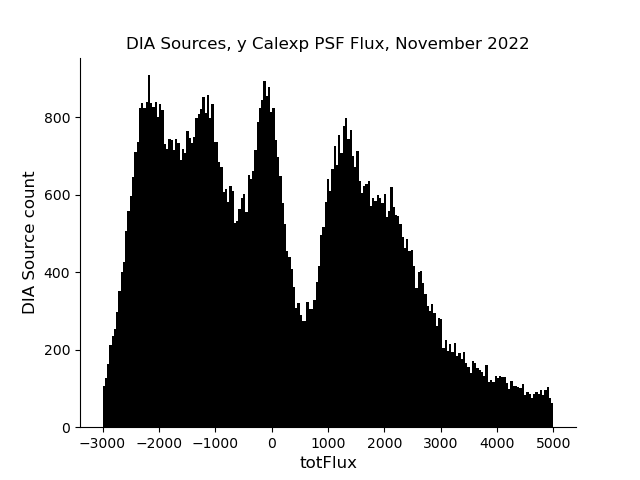

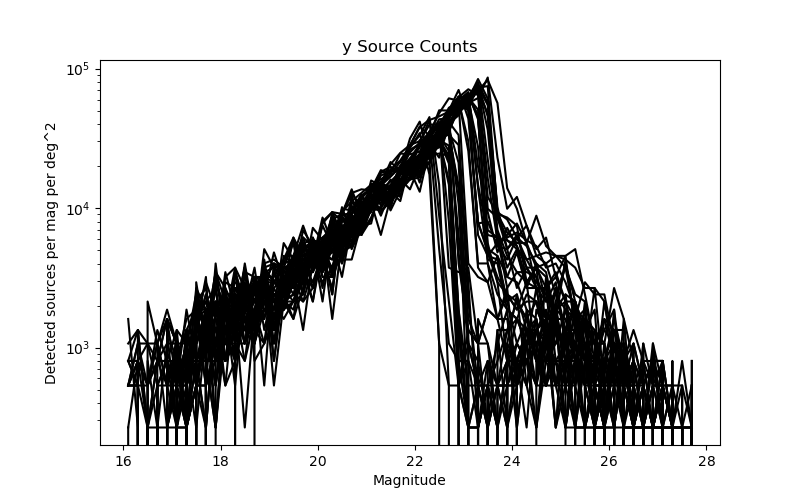

In [12]:
collection = collections

for band, color in zip(bandList, colorList):
    plac.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == band], fluxType='psFlux',
                        title=f'DIA Sources, {band} Diffim PSF Flux, {month} {year}', color1=color, binmin=-3e3, binmax=3e3)
    plac.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == band], fluxType='totFlux',
                        title=f'DIA Sources, {band} Calexp PSF Flux, {month} {year}', color1=color, binmin=-3e3, binmax=5e3)
    plac.source_magnitude_histogram(repo, goodSrc, band, 'HSC', collection)

## 3. Comparison to previous processing run

Current run does not appear to have changed significantly from previous run. Objects, sources, and flags are consistent.

In [13]:
xlim = (151.05, 149.40)
ylim = (1.45, 3.03)

Text(0.5, 0.98, 'All DIA Sources (with fakes)')

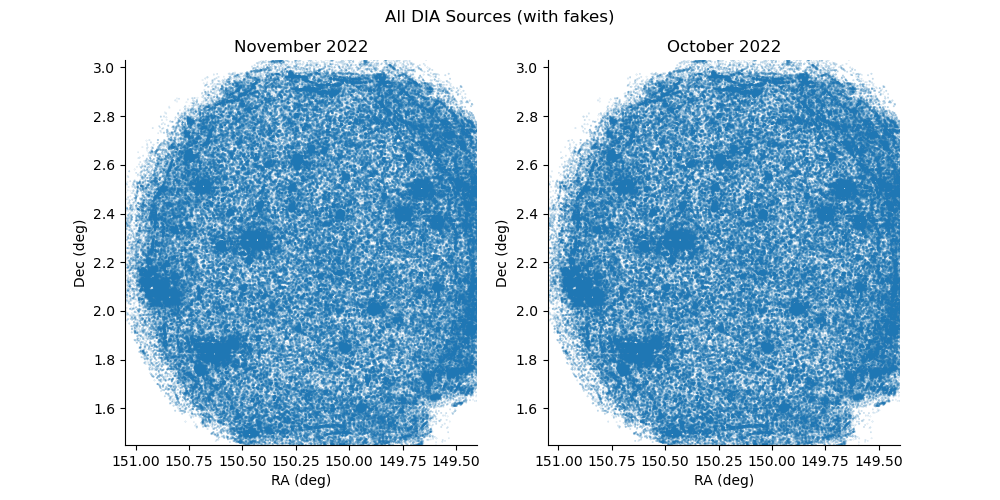

In [14]:
fig = plt.figure(figsize=(10,5))

cutoff = 0  # only plot DIA Objects composed of cutoff or more DIA Sources

ax = fig.add_subplot(121)
plt.setp(ax, xlim=xlim, ylim=ylim)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(goodObj.loc[goodObj['nDiaSources'] > cutoff, 'ra'], goodObj.loc[goodObj['nDiaSources'] > cutoff, 'decl'], 
           c='C0', s=goodObj.loc[goodObj['nDiaSources'] > cutoff, 'nDiaSources']/10, marker='.', alpha=0.4)
ax.set_xlabel('RA (deg)')
ax.set_ylabel('Dec (deg)')
ax.set_title(f'{month} {year}')

ax2 = fig.add_subplot(122)
plt.setp(ax2, xlim=xlim, ylim=ylim)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.scatter(goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'ra'], 
            goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'decl'], 
            c='C0', s=goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'nDiaSources']/10, 
            marker='.', alpha=0.4)
ax2.set_xlabel('RA (deg)')
ax2.set_ylabel('Dec (deg)')
ax2.set_title(f'{month_old} {year_old}')

plt.suptitle('All DIA Sources (with fakes)')

Text(0.5, 0.98, 'DIA Objects composed of > 3 "Good" DIA Sources (with fakes)')

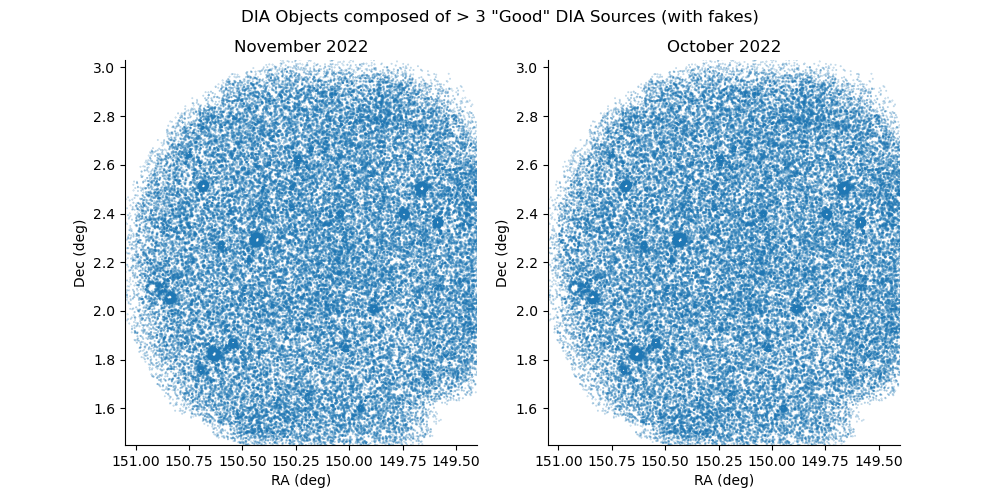

In [15]:
fig = plt.figure(figsize=(10,5))

cutoff = 3  # only plot DIA Objects composed of cutoff or more DIA Sources

ax = fig.add_subplot(121)
plt.setp(ax, xlim=xlim, ylim=ylim)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(goodObj.loc[goodObj['nDiaSources'] > cutoff, 'ra'], goodObj.loc[goodObj['nDiaSources'] > cutoff, 'decl'], 
           c='C0', s=goodObj.loc[goodObj['nDiaSources'] > cutoff, 'nDiaSources']/10, marker='.', alpha=0.4)
ax.set_xlabel('RA (deg)')
ax.set_ylabel('Dec (deg)')
ax.set_title(f'{month} {year}')

ax2 = fig.add_subplot(122)
plt.setp(ax2, xlim=xlim, ylim=ylim)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.scatter(goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'ra'], 
            goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'decl'], 
            c='C0', s=goodObj_old.loc[goodObj_old['nDiaSources'] > cutoff, 'nDiaSources']/10, 
            marker='.', alpha=0.4)
ax2.set_xlabel('RA (deg)')
ax2.set_ylabel('Dec (deg)')
ax2.set_title(f'{month_old} {year_old}')

plt.suptitle(f'DIA Objects composed of > {cutoff} "Good" DIA Sources (with fakes)')

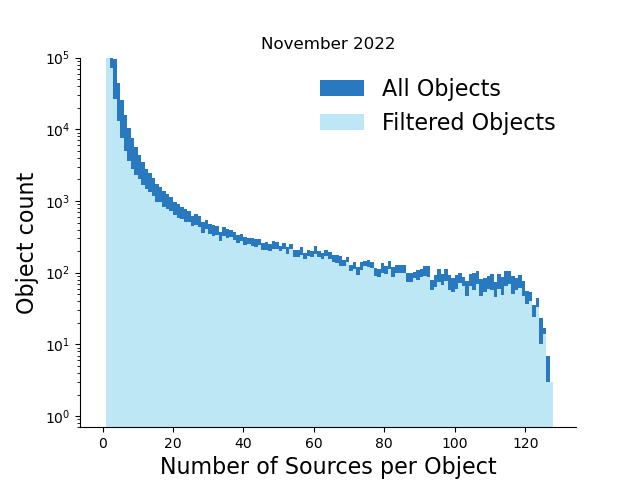

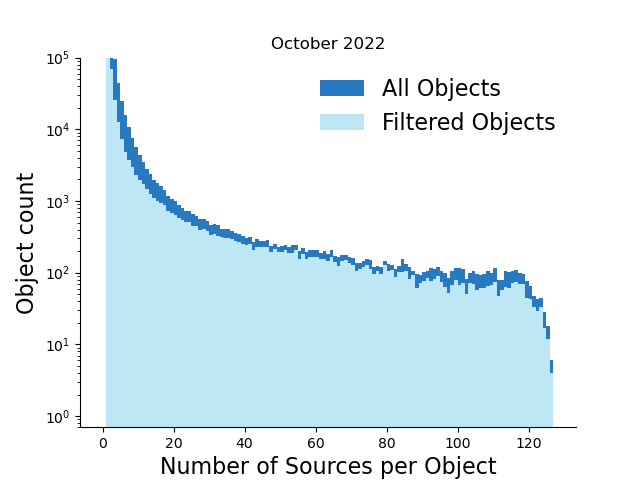

In [16]:
plac.plotDiaObjectHistogram(objTable, goodObj, title=f'{month} {year}');
plac.plotDiaObjectHistogram(objTable_old, goodObj_old, title=f'{month_old} {year_old}');

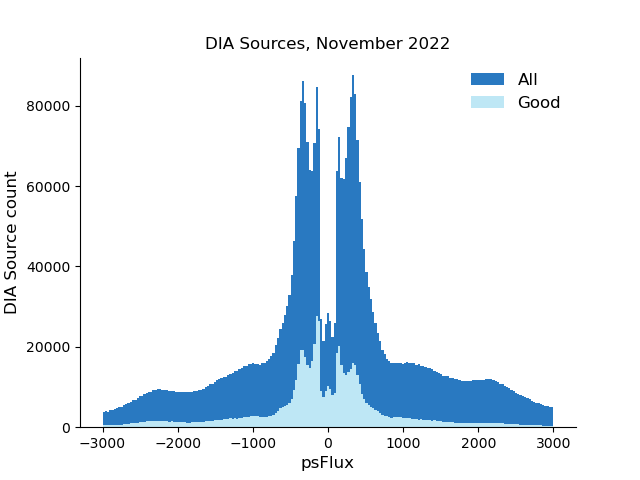

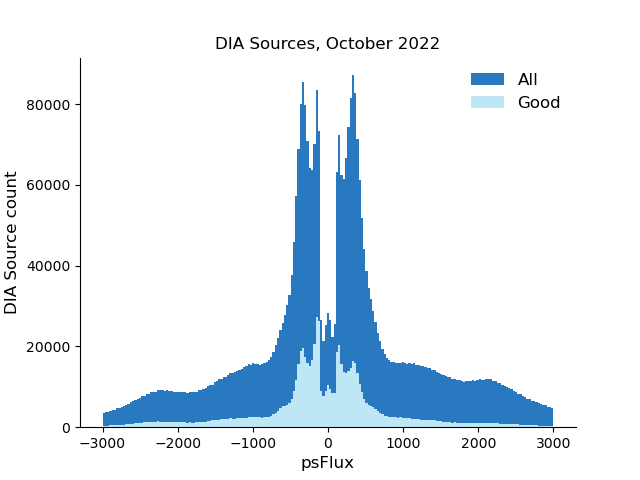

In [17]:
plac.plotFluxHistSrc(srcTable, goodSrc, fluxType='psFlux', label1='All', label2='Good',
                title=f'DIA Sources, {month} {year}')
plac.plotFluxHistSrc(srcTable_old, goodSrc_old, fluxType='psFlux', label1='All', label2='Good',
                title=f'DIA Sources, {month_old} {year_old}')

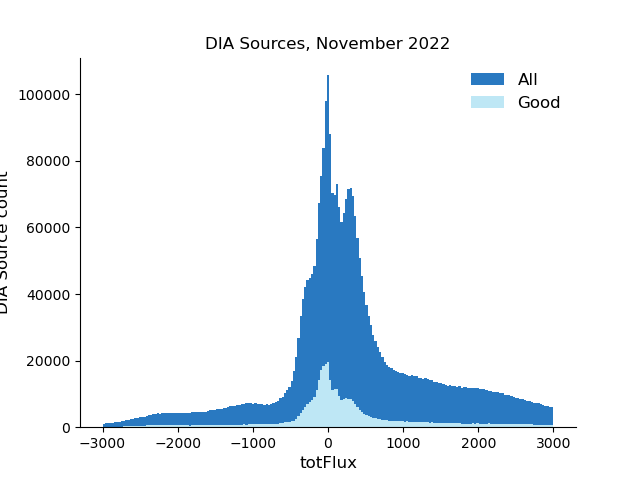

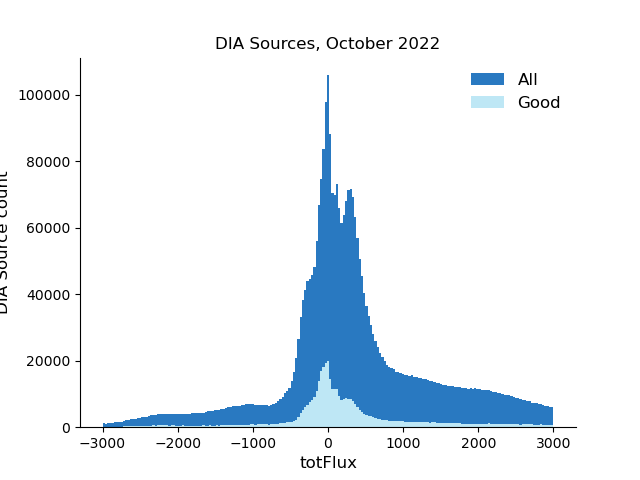

In [18]:
plac.plotFluxHistSrc(srcTable, goodSrc, fluxType='totFlux', label1='All', label2='Good',
                title=f'DIA Sources, {month} {year}')
plac.plotFluxHistSrc(srcTable_old, goodSrc_old, fluxType='totFlux', label1='All', label2='Good',
                title=f'DIA Sources, {month_old} {year_old}')

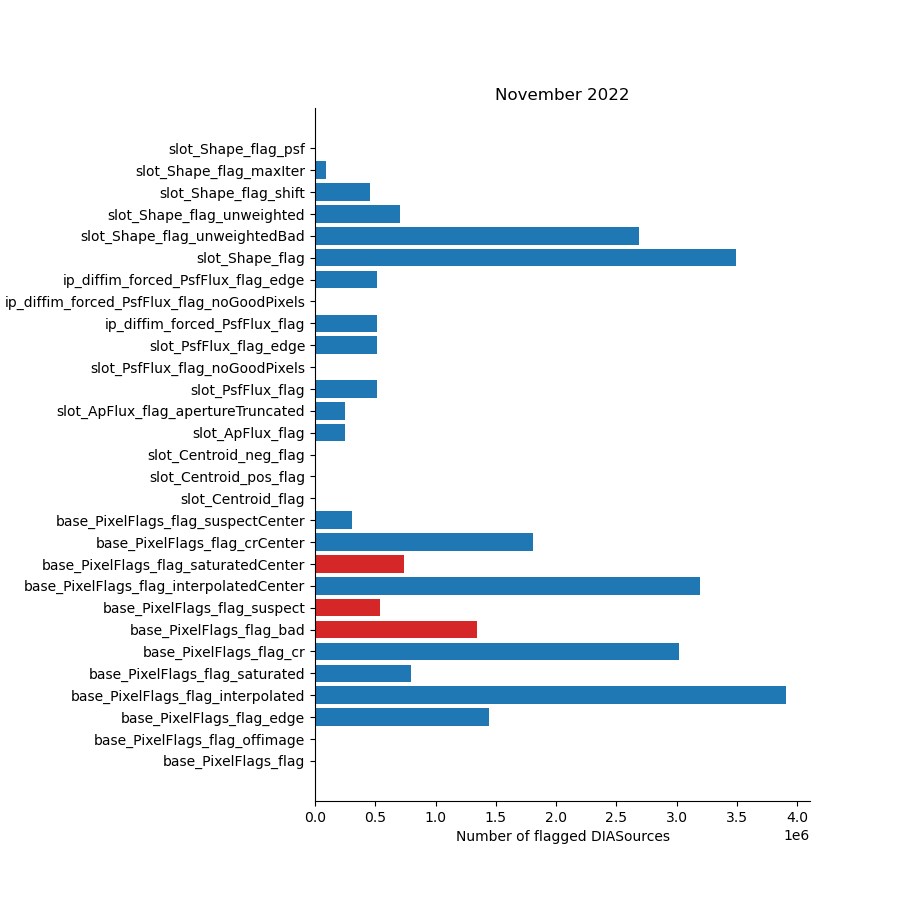

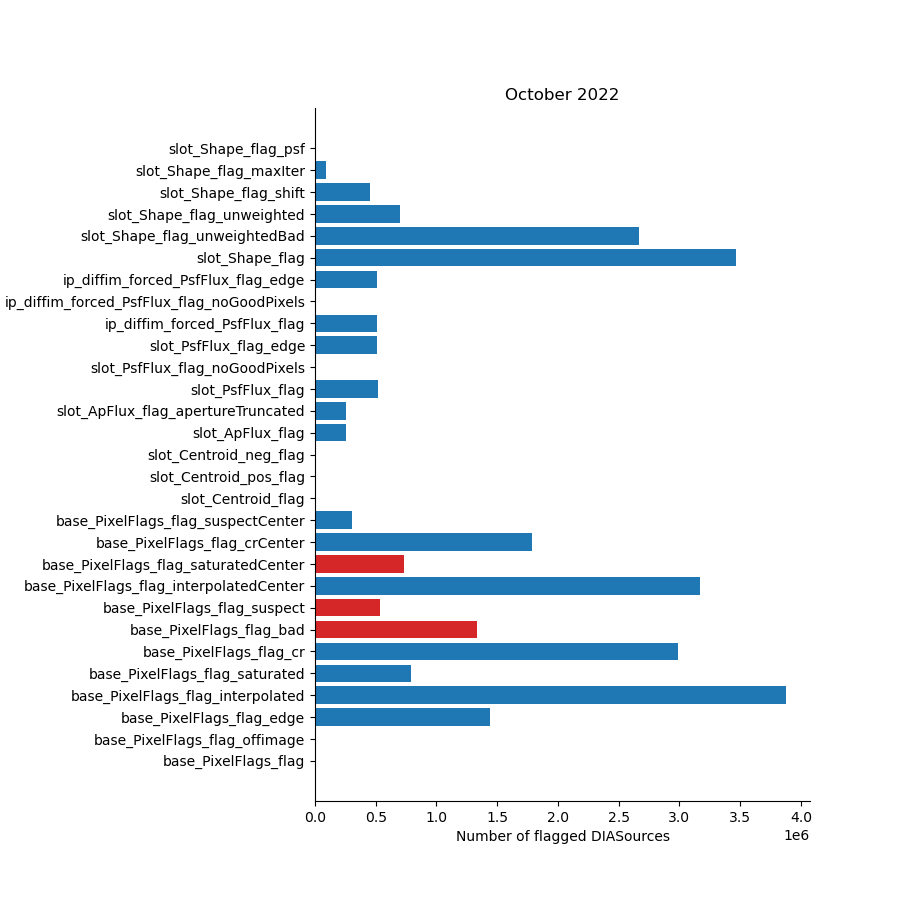

In [19]:
plac.plotFlagHist(srcTable, title=f'{month} {year}')
plac.plotFlagHist(srcTable_old, title=f'{month_old} {year_old}')

Text(0.5, 1.0, 'Comparing DIA Object and Source counts (with fakes)')

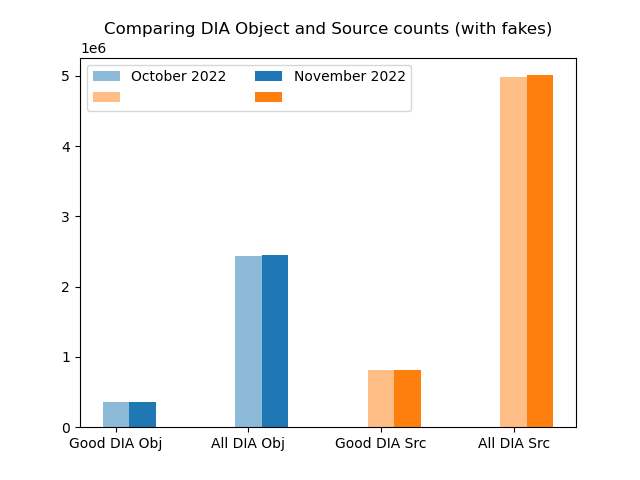

In [20]:
label1 = f'{month_old} {year_old}'
label2 = f'{month} {year}'

fig, ax = plt.subplots()
barLabels = ['Good DIA Obj', 'All DIA Obj', 'Good DIA Src', 'All DIA Src']
xbar = np.array([0, 1])
width = 0.2

# Previous Run
ax.bar(xbar, [len(goodObj_old), len(objTable_old)], 
       width, label=label1, color='C0', alpha=0.5)
ax.bar(xbar + 2, [len(goodSrc_old), len(srcTable_old)],
       width, label=' ', color='C1', alpha=0.5)

# Current Run
ax.bar(xbar + width, [len(goodObj), len(objTable)], 
       width, label=label2, color='C0')
ax.bar(xbar + 2 + width, [len(goodSrc), len(srcTable)],
       width, label=' ', color='C1')

plt.legend(ncol=2)
ax.set_xticks([0, 1, 2, 3])
labels = ax.set_xticklabels(barLabels)
plt.title('Comparing DIA Object and Source counts (with fakes)')

## 4. Separating the fake sources from the real sources

Significant (almost complete) loss of fakes matched to DIA sources.

In [21]:
tractList = [9813]

In [22]:
dfs = [butler.get('fakes_fakeSourceCat', collections=collections,
                 instrument=instrument, skymap=skymap, tract=tract) for tract in tractList]
allInjectedFakes = pd.concat(dfs, ignore_index=True)

In [23]:
allInjectedFakes

,fakeId,dec,ra,isVisitSource,isTemplateSource,u_mag,g_mag,r_mag,i_mag,z_mag,y_mag,disk_semimajor,bulge_semimajor,disk_n,bulge_n,disk_axis_ratio,bulge_axis_ratio,disk_pa,bulge_pa,sourceType
0,11373047229644448441,0.030411,2.621597,True,False,25.160898,25.160898,25.160898,25.160898,25.160898,25.160898,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
1,13639280000677671531,0.034815,2.621040,True,False,20.642687,20.642687,20.642687,20.642687,20.642687,20.642687,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
2,10395618773087032890,0.042081,2.603423,True,False,23.876662,23.876662,23.876662,23.876662,23.876662,23.876662,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
3,12890823050440864715,0.040334,2.636729,True,False,25.118767,25.118767,25.118767,25.118767,25.118767,25.118767,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
4,11536772019537546938,0.033896,2.629257,True,False,23.367207,23.367207,23.367207,23.367207,23.367207,23.367207,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8858,12536778159074702183,0.043717,2.610436,False,True,20.013189,20.013189,20.013189,20.013189,20.013189,20.013189,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
8859,10364346386367408018,0.055644,2.621685,False,True,21.096544,21.096544,21.096544,21.096544,21.096544,21.096544,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
8860,11501808663333695388,0.040447,2.606848,False,True,24.345681,24.345681,24.345681,24.345681,24.345681,24.345681,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star
8861,13124672865070043389,0.036272,2.603944,False,True,23.850171,23.850171,23.850171,23.850171,23.850171,23.850171,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,star


In [24]:
dfs_old = [butler.get('fakes_fakeSourceCat', collections=collections_old,
                 instrument=instrument, skymap=skymap, tract=tract) for tract in tractList]
allInjectedFakes_old = pd.concat(dfs, ignore_index=True)

In [25]:
def collectMatchedDiaSources(fakesMatchDiaSrc, maxi=-1):
    """Given a butler query of fakesMatchDiaSrc datasetRefs, create a pandas dataframe with them all.
    'All' is defined as up to maxi of them, so it doesn't take forever.
    
    If you really want all of them, set maxi to -1.
    """
    #%%time
    visitDetectorFrames = []

    i = 0

    for datasetRef in fakesMatchDiaSrc: 
        try:
            frame = butler.getDirect(datasetRef)
            # nondetected sources don't have DIASource records--so propagate metadata to all rows
            # grab a detected row
            w = frame['diaSourceId'] > 0
            if np.sum(w) == 0:
                print(f'No real sources detected in {datasetRef}')
                continue
            ccdVisitId = int(frame.loc[w,'ccdVisitId'].iloc[0])
            filterName = frame.loc[w,'filterName'].iloc[0]
            # propagate to all rows
            frame.loc[:,'ccdVisitId'] = ccdVisitId 
            frame.loc[:,'filterName'] = filterName 
        except Exception as e:
            raise(e)
        else:
            visitDetectorFrames.append(frame)
        i+=1
        if i == maxi:
            break

    matchedDiaSources = pd.concat(visitDetectorFrames)

    matchedDiaSources.loc[:,'ra'] = np.degrees(matchedDiaSources['ra_x'])
    matchedDiaSources.loc[:,'decl'] = np.degrees(matchedDiaSources['dec'])

    return matchedDiaSources

In [26]:
fakesMatchDiaSrc = butler.registry.queryDatasets(collections=collections,
                                                 datasetType='fakes_goodSeeingDiff_matchDiaSrc')
matchedDiaSources = collectMatchedDiaSources(fakesMatchDiaSrc)

In [27]:
fakesMatchDiaSrc_old = butler.registry.queryDatasets(collections=collections_old,
                                                 datasetType='fakes_goodSeeingDiff_matchDiaSrc')
matchedDiaSources_old = collectMatchedDiaSources(fakesMatchDiaSrc_old)

No real sources detected in fakes_goodSeeingDiff_matchDiaSrc@{instrument: 'HSC', detector: 69, visit: 29340, ...}, sc=DataFrame] (id=5c1ac727-faf3-41a2-88a6-51a626e12ff8)


In [28]:
instrumentDataId = butler.registry.expandDataId(instrument=instrument)
packer = butler.registry.dimensions.makePacker("visit_detector", instrumentDataId)
dataId = packer.unpack(matchedDiaSources.ccdVisitId)
matchedDiaSources['visit'] = dataId['visit']
matchedDiaSources['detector'] = dataId['detector']

In [29]:
matchedDiaSources

,fakeId,dec,ra_x,isVisitSource,isTemplateSource,u_mag,g_mag,r_mag,i_mag,z_mag,...,totFluxErr,ixx,iyy,ixy,ixxPSF,iyyPSF,ixyPSF,ra,visit,detector
0,9394887735841883106,0.033792,2.627034,True,False,20.582495,20.582495,20.582495,20.582495,20.441910,...,62.331009,0.064784,0.061525,-0.010752,0.063956,-0.010408,-0.010408,150.517934,17934,32
1,13610879020107537588,0.034956,2.624991,True,False,22.380182,22.380182,22.380182,22.380182,23.317322,...,57.574864,0.082050,0.078064,-0.009533,0.065366,-0.010638,-0.010638,150.400882,17934,32
2,13227678128177397496,0.034157,2.626543,True,False,21.155165,21.155165,21.155165,21.155165,21.028979,...,60.328145,0.063872,0.062020,-0.010808,0.064363,-0.010474,-0.010474,150.489852,17934,32
3,10132502560900742964,0.034747,2.624208,True,False,21.953599,21.953599,21.953599,21.953599,22.252617,...,57.571310,0.065621,0.064615,-0.009836,0.065606,-0.010677,-0.010677,150.356046,17934,32
4,10455010750048721844,0.033804,2.625849,True,False,21.097506,21.097506,21.097506,21.097506,21.317799,...,59.618408,0.065848,0.062673,-0.012680,0.064636,-0.010519,-0.010519,150.450072,17934,32
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32,13343724150824288791,0.039882,2.621507,False,True,24.866236,24.866236,24.866236,24.866236,24.866236,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,150.201315,348,49
33,11595338806289845676,0.039256,2.619901,False,True,21.406095,21.406095,21.406095,21.406095,21.406095,...,282.129257,NaN,NaN,NaN,0.186222,0.004626,0.004626,150.109294,348,49
34,9994235125033671675,0.039131,2.621841,False,True,22.691766,22.691766,22.691766,22.691766,22.691766,...,278.986922,NaN,NaN,NaN,0.185647,0.004612,0.004612,150.220441,348,49
35,13041437128519418459,0.038625,2.620584,False,True,24.878170,24.878170,24.878170,24.878170,24.878170,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,150.148402,348,49


In [30]:
dataId_old = packer.unpack(matchedDiaSources_old.ccdVisitId)
matchedDiaSources_old['visit'] = dataId_old['visit']
matchedDiaSources_old['detector'] = dataId_old['detector']

Text(0.5, 1.0, 'DIA Objects, Fakes, and Matched DIA Sources, November 2022')

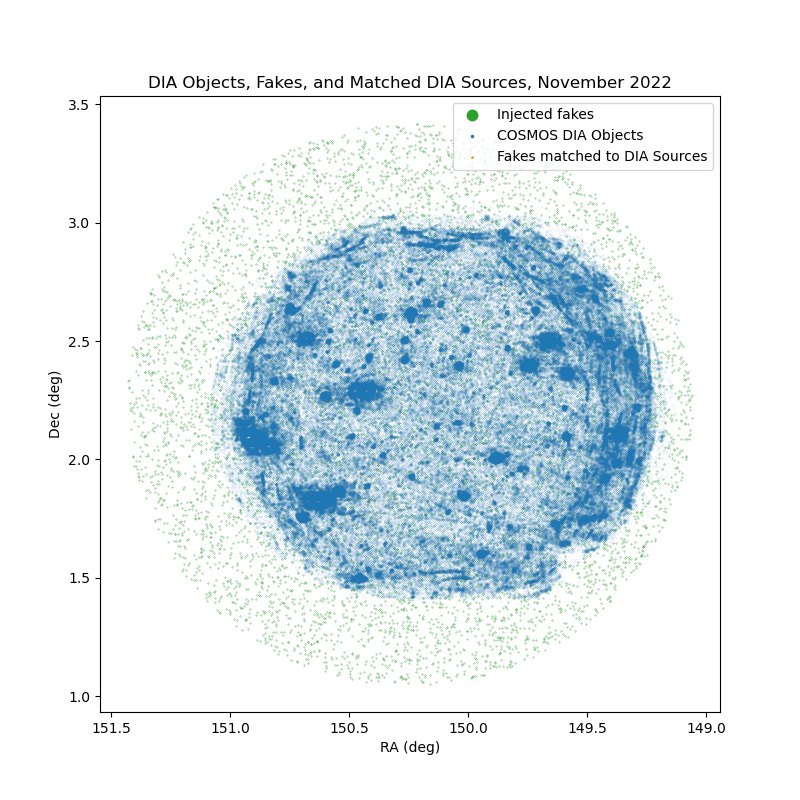

In [31]:
plt.figure(figsize=(8,8))
plt.plot(allInjectedFakes.ra*u.rad.to(u.deg), allInjectedFakes.dec*u.rad.to(u.deg),
         ls='None', marker='.', ms=0.5, label="Injected fakes", color='C2')
plt.plot(goodObj.ra, goodObj.decl, ls='None', marker='.', ms=0.1, label="COSMOS DIA Objects", color='C0')
plt.plot(matchedDiaSources.ra_x*u.rad.to(u.deg), matchedDiaSources.dec*u.rad.to(u.deg), ls='None', marker='.',
         ms=0.05, label="Fakes matched to DIA Sources", color='C1')
plt.gca().invert_xaxis()
plt.xlabel("RA (deg)")
plt.ylabel("Dec (deg)")
plt.legend(markerscale=30)
plt.title(f'DIA Objects, Fakes, and Matched DIA Sources, {month} {year}')

In [32]:
nFakesMatched = len(matchedDiaSources)
nFakesMatched_old = len(matchedDiaSources_old)

print(f"{month} {year}, Number of matched fake sources:", nFakesMatched)
print(f"{month_old} {year_old}, Number of matched fake sources:", nFakesMatched_old)

print("Diff: ", nFakesMatched-nFakesMatched_old)

November 2022, Number of matched fake sources: 705
October 2022, Number of matched fake sources: 477091
Diff:  -476386


In [33]:
nFakesDiff = len(srcTable) - nFakesMatched
nFakesDiff_old = len(srcTable_old) - nFakesMatched_old

print(f"{month} {year}, Number of non-fake DIA Sources: ", nFakesDiff)
print(f"{month_old} {year_old}, Number of non-fake DIA Sources: ", nFakesDiff_old)

print("Diff: ", nFakesDiff-nFakesDiff_old)

November 2022, Number of non-fake DIA Sources:  5007030
October 2022, Number of non-fake DIA Sources:  4500871
Diff:  506159


In [34]:
nGood = len(goodSrc)
nGood_old = len(goodSrc_old)

print(f"{month} {year}, Number of good sources: ",nGood)
print(f"{month_old} {year_old}, Number of good sources: ",nGood_old)

print("Diff: ", nGood-nGood_old)

November 2022, Number of good sources:  819928
October 2022, Number of good sources:  818648
Diff:  1280


visit 318: 18871 DIA Sources, 0 matched injected fakes
visit 322: 22637 DIA Sources, 0 matched injected fakes
visit 324: 19456 DIA Sources, 0 matched injected fakes
visit 326: 19835 DIA Sources, 0 matched injected fakes
visit 328: 21690 DIA Sources, 0 matched injected fakes
visit 330: 20237 DIA Sources, 0 matched injected fakes
visit 332: 18565 DIA Sources, 0 matched injected fakes
visit 344: 19187 DIA Sources, 0 matched injected fakes
visit 346: 20475 DIA Sources, 44 matched injected fakes
visit 348: 22382 DIA Sources, 37 matched injected fakes
visit 350: 20339 DIA Sources, 0 matched injected fakes
visit 352: 20099 DIA Sources, 0 matched injected fakes
visit 354: 20951 DIA Sources, 0 matched injected fakes
visit 356: 20878 DIA Sources, 0 matched injected fakes
visit 358: 19855 DIA Sources, 0 matched injected fakes
visit 360: 19799 DIA Sources, 0 matched injected fakes
visit 362: 20144 DIA Sources, 41 matched injected fakes
visit 1166: 22937 DIA Sources, 0 matched injected fakes
visit 

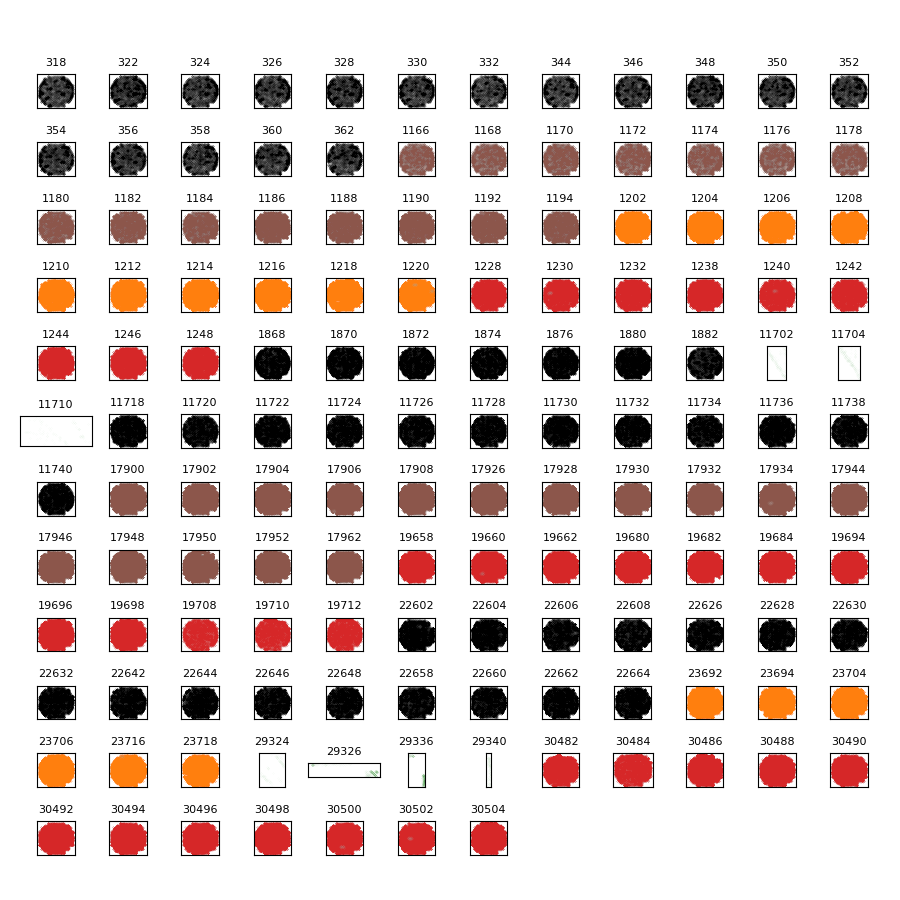

In [35]:
# Plot visit-by-visit: DIA Sources (blue) and inserted fakes (orange)

sourceTablePlot = srcTable

visits = np.unique(sourceTablePlot['visit'])
nVisits = len(visits)
if np.floor(np.sqrt(nVisits)) - np.sqrt(nVisits) == 0:
    squareGridSize = int(np.sqrt(nVisits))
else:
    squareGridSize = int(np.sqrt(nVisits)) + 1

fig = plt.figure(figsize=(9, 9))
for count, visit in enumerate(np.unique(sourceTablePlot['visit'].values)):
    band = sourceTablePlot.loc[(sourceTablePlot.visit == visit), 'filterName'].iloc[0]
    color = [colorList[0] if band==bandList[0] else 
             colorList[1] if band==bandList[1] else 
             colorList[2] if band==bandList[2] else 
             colorList[3] if band==bandList[3] else 
             colorList[4] if band==bandList[4] else 
             colorList[5]]
    idx = sourceTablePlot.visit == visit
    ax = fig.add_subplot(squareGridSize, squareGridSize, count + 1, aspect='equal')
    ax.scatter(sourceTablePlot.ra[idx], sourceTablePlot.decl[idx], c=color, marker='.', s=0.005, alpha=0.3)
    
    fakeSources = matchedDiaSources.loc[matchedDiaSources.visit == visit]
    ax.scatter(fakeSources.ra_x*u.rad.to(u.deg), fakeSources.dec*u.rad.to(u.deg),
               c='0.75', marker='.', s=0.02, alpha=0.3)
    
    ax.set_title(visit, size=8)
    ax.invert_xaxis()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    print(f'visit {visit}: {len(sourceTablePlot.loc[sourceTablePlot.visit == visit])} DIA Sources, {len(fakeSources)} matched injected fakes')

fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(wspace=0)

Text(0.5, 1.0, 'Stacked Visits, November 2022')

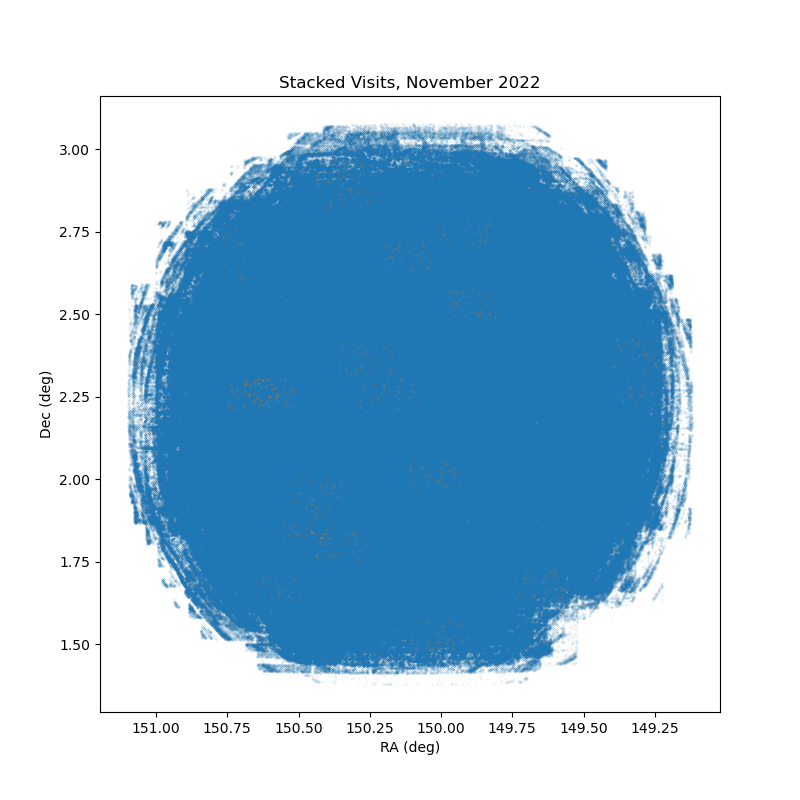

In [36]:
# Same as above but all on top of each other instead of broken out by visit
plt.figure(figsize=(8, 8))
plt.scatter(srcTable['ra'], srcTable['decl'],c='C0', s=0.01, alpha=0.5, label="COSMOS DIA Objects")
plt.scatter(matchedDiaSources.ra_x*u.rad.to(u.deg), matchedDiaSources.dec*u.rad.to(u.deg), c='C1', s=0.05, alpha=0.5, label="Fakes matched to DIA Sources")
plt.gca().invert_xaxis()
plt.xlabel('RA (deg)')
plt.ylabel('Dec (deg)')
plt.title(f'Stacked Visits, {month} {year}')

## 5. Fakes completeness analysis 

All plots are significantly different from previous run. Spatial distribution is now clustered in ~13 small areas rather than evenly distributed through the plot. The completeness plots show that all bands are incomplete, not just g band. Something happened with fakes in the November run.

In [37]:
def completenessByBandPlot(matchedDiaSources, bandList, colorList, flux_col_suffix='_mag', doRaDecCut=False):

    completeness_byband = {}
    completeness_err_byband = {}
    bins = np.linspace(20, 26, 70)
    
    # Some filters
    wScienceOnly = matchedDiaSources['isVisitSource'] & ~matchedDiaSources['isTemplateSource']
    wMatched = matchedDiaSources['diaSourceId'] > 0
    
    if doRaDecCut:
        # Spatial cut  # probably redundant now that we do RA/Dec cut in trimFakes
        minra = matchedDiaSources.loc[wScienceOnly & wMatched,'ra'].min()
        maxra = matchedDiaSources.loc[wScienceOnly & wMatched,'ra'].max()
        mindecl = matchedDiaSources.loc[wScienceOnly & wMatched,'decl'].min()
        maxdecl = matchedDiaSources.loc[wScienceOnly & wMatched,'decl'].max()
        wRADec = (matchedDiaSources.ra < maxra) & (matchedDiaSources.ra > minra) & \
                 (matchedDiaSources.decl > mindecl) & (matchedDiaSources.decl < maxdecl)

    for band in bandList:
        wband = matchedDiaSources['filterName'] == band

        if doRaDecCut:
            matched_filter = (wMatched & wScienceOnly & wRADec & wband)
            unmatched_filter = (~wMatched & wScienceOnly & wRADec & wband)
        else:
            matched_filter = (wMatched & wScienceOnly &  wband)
            unmatched_filter = (~wMatched & wScienceOnly & wband)

        n_matched, edges = np.histogram(matchedDiaSources.loc[matched_filter, f'{band}{flux_col_suffix}'], bins=bins)
        n_unmatched, edges = np.histogram(matchedDiaSources.loc[unmatched_filter, f'{band}{flux_col_suffix}'], bins=bins)

        ntot = n_matched + n_unmatched
        nmatched_err = np.sqrt(n_matched)
        completeness_byband[band] = n_matched/ntot

        # Attempt to compute some kind of error
        ntot_err = np.sqrt(ntot) # compute on total to keep Poisson errors in gaussian regime
        completeness_err_byband[band] = completeness_byband[band] * \
                                        np.sqrt((nmatched_err/n_matched)**2. + (ntot_err/ntot)**2.)
    
    plt.figure()
    plt.title('Spatial distribution of matched DIA Sources')
    plt.scatter(matchedDiaSources.loc[wScienceOnly & wMatched,'ra'], \
                matchedDiaSources.loc[wScienceOnly & wMatched,'decl'],
                marker='x', s=3, label='Matched science fake')
    plt.scatter(matchedDiaSources.loc[wScienceOnly & ~wMatched,'ra'], \
                matchedDiaSources.loc[wScienceOnly & ~wMatched,'decl'],
                marker='.', s=3, label='Unmatched science fake')
    plt.legend()
    
    if len(bandList) > 1:
        fig, axs = plt.subplots(3, 2, figsize=(9, 12))
        axG = axs[0, 0]
        axR = axs[0, 1]
        axI = axs[1, 0]
        axZ = axs[1, 1]
        axY = axs[2, 0]
        #axHits = axs[2, 1]
        ax0 = axs[2, 1]
        ax0.axis('off')
        axList = [axG, axR, axI, axZ, axY]
        colorList = ['C2', 'C1', 'C3', 'C5', 'k']
        xlim = (20,26)
        ylim = (0, 1)
        plt.setp(axs, xlim=xlim, ylim=ylim)
        fig.suptitle(f'Completeness')
        for ax, band, color in zip(axList, bandList, colorList):
            ax.errorbar(bins[0:-1], completeness_byband[band], completeness_err_byband[band], color=color)
    
    plt.figure(figsize=(8, 6))
    for band, color in zip(bandList, colorList):
        plt.errorbar(bins[0:-1], completeness_byband[band], completeness_err_byband[band], color=color, label=band)
    plt.axhline(.9, ls='--', color='0.75')#, label='90%')
    plt.legend(loc='lower left')
    plt.xlabel('Injected magnitude')
    plt.ylabel('Fractional completeness')
    plt.title('Completeness for sources injected into science (visit) images')

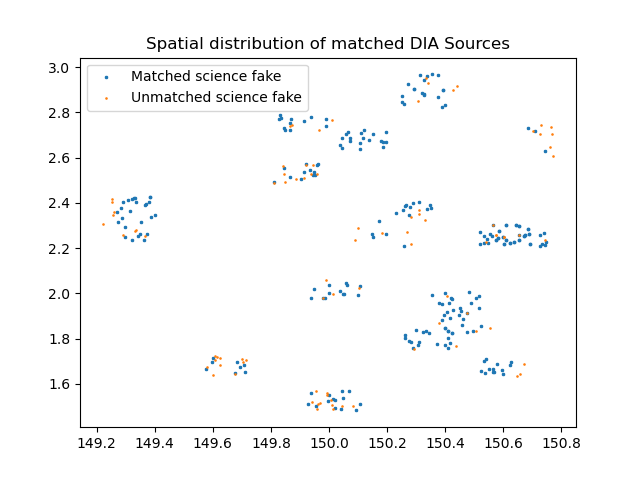

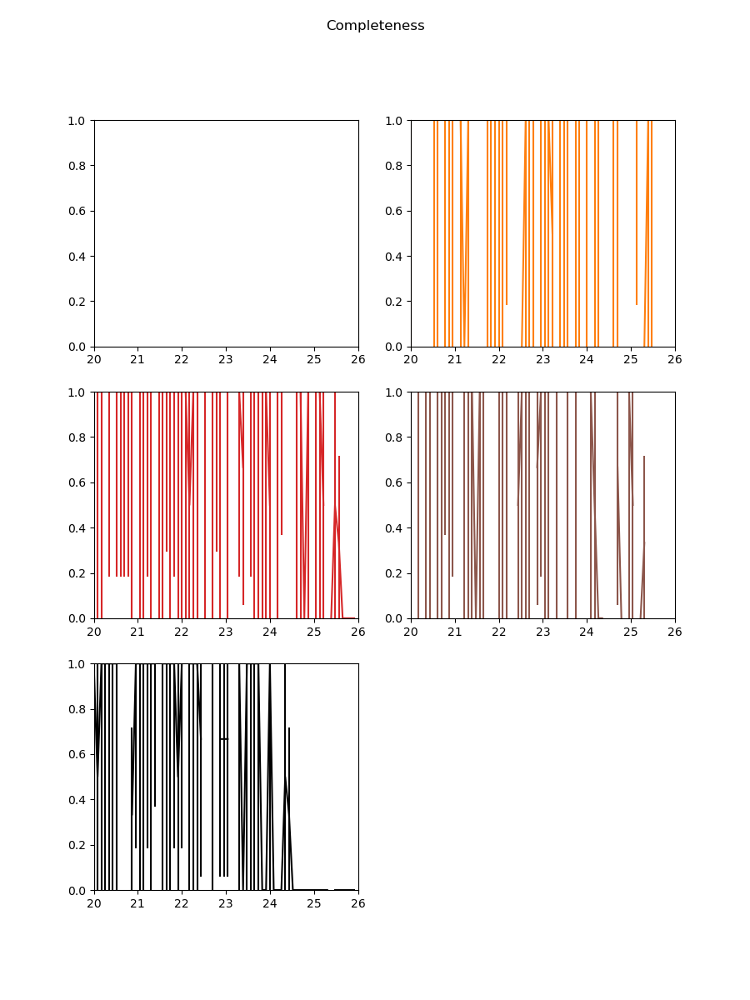

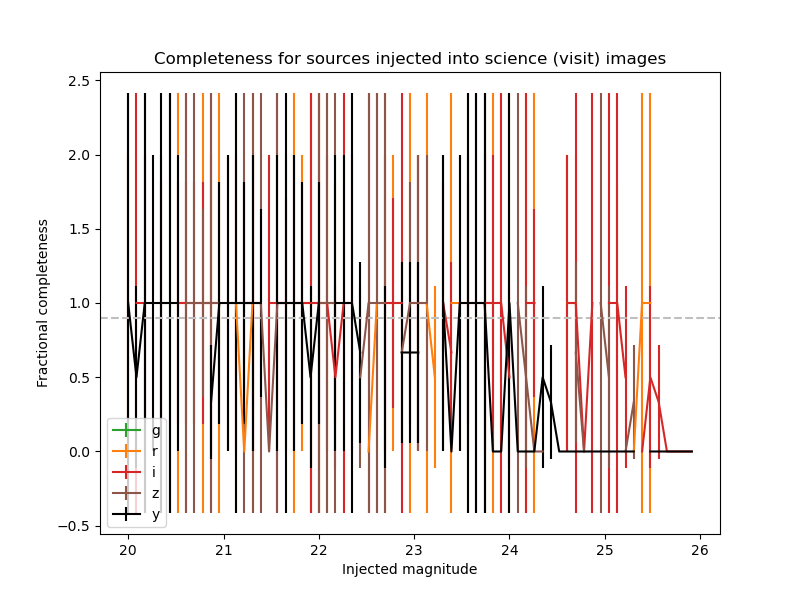

In [38]:
completenessByBandPlot(matchedDiaSources, bandList, colorList,
                       flux_col_suffix='_mag', doRaDecCut=False)

## 6. Calexp and PSF analysis

Plots are consistent with previous run. Accepted and rejected PSF sources are evenly distributed.

In [39]:
%matplotlib inline

In [40]:
visits = [29350]
detectors = [49]

Collection:  u/elhoward/DM-35285/hsc-output-collection , Visit:  29350 , Detector:  49


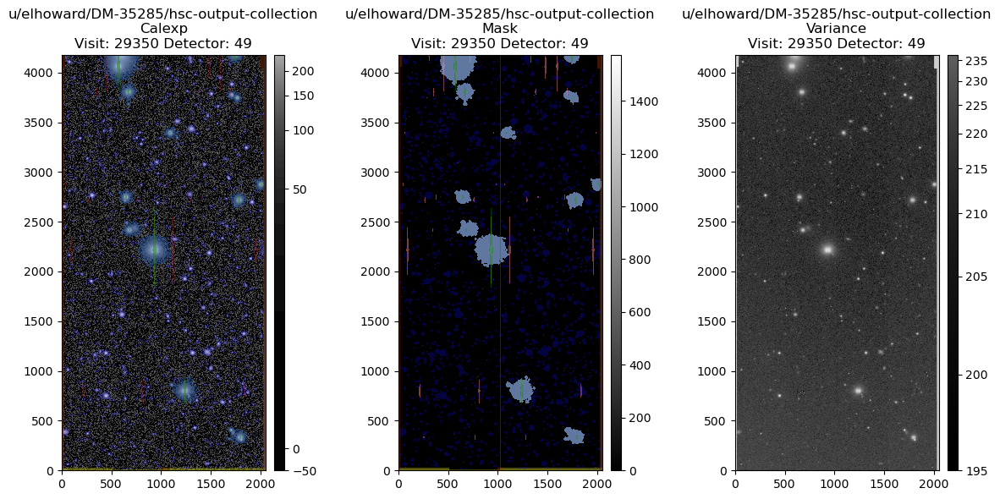

Collection:  u/smart/DM-36389/hsc-output-collection , Visit:  29350 , Detector:  49


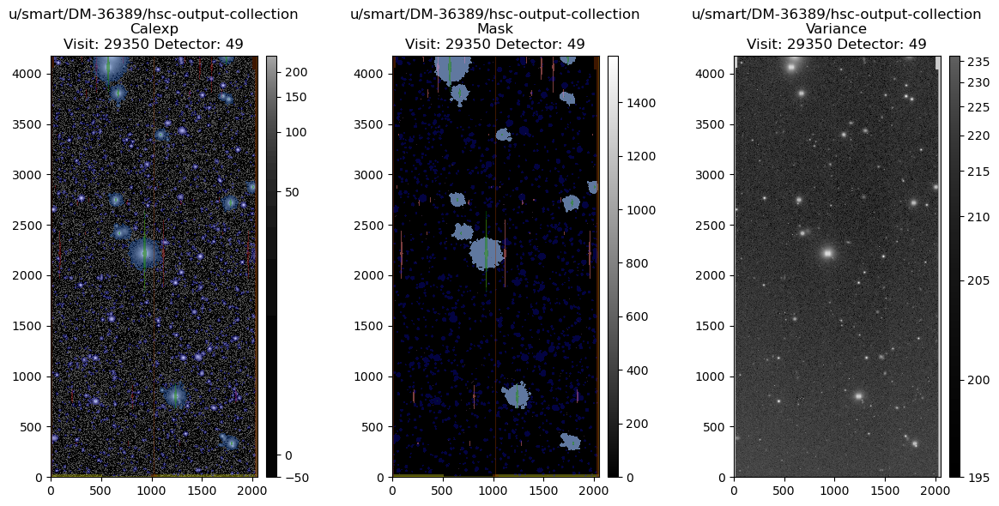

In [41]:
for collection in collectionsList:
    for visit in visits:
        for detector in detectors:
            print('Collection: ', collection,
                  ', Visit: ', visit,
                  ', Detector: ', detector)
            afwDisplay.setDefaultBackend('matplotlib') 

            calexp = butler.get('calexp', instrument='HSC',
                                visit=visit, detector=detector, collections=collection)
            fig, (ax1,ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))

            plt.sca(ax1)  # set the first axis as current
            display1 = afwDisplay.Display(frame=fig)
            display1.scale('asinh', -1, 30)
            display1.mtv(calexp, f'{collection}\nCalexp\nVisit: {visit} Detector: {detector}')

            plt.sca(ax2)  # set the second axis as current
            display2 = afwDisplay.Display(frame=fig)
            display2.mtv(calexp.mask, f'{collection}\nMask\nVisit: {visit} Detector: {detector}')

            plt.sca(ax3) # set the third axis as current
            display3 = afwDisplay.Display(frame=fig)
            display3.scale('asinh', 'zscale')
            display3.mtv(calexp.variance, f'{collection}\nVariance\nVisit: {visit} Detector: {detector}')

            plt.tight_layout()
            plt.show()
            plt.close(fig)

Visit:  29350 , Detector:  49


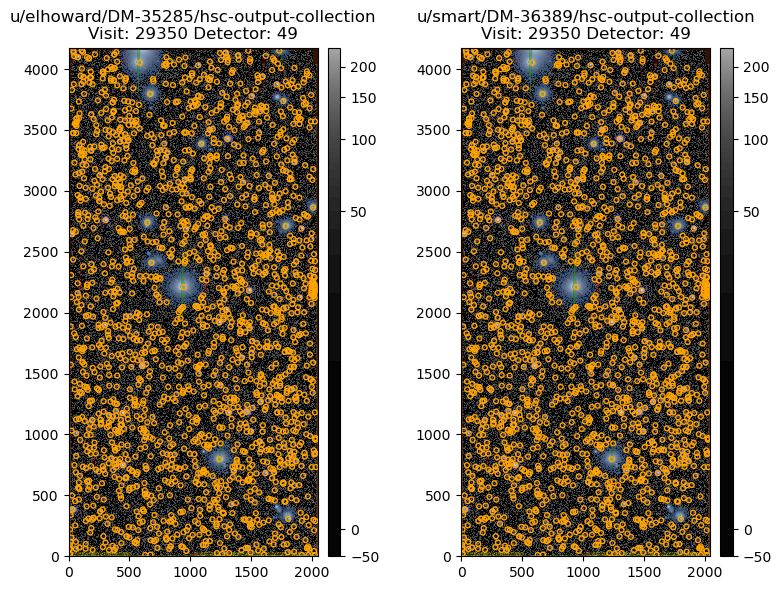

In [42]:
for visit in visits:
    for detector in detectors:
        print('Visit: ', visit, ', Detector: ', detector)
        afwDisplay.setDefaultBackend('matplotlib') 

        fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(8, 6))

        plt.sca(ax1)  # set the first axis as current
        calexp1 = butler.get('calexp', instrument=instrument,
                        visit=visit, detector=detector, collections=collections)
        display1 = afwDisplay.Display(frame=fig)
        display1.setMaskTransparency(80)
        display1.scale('asinh', -1, 30)
        display1.mtv(calexp1, f'{collections}\nVisit: {visit} Detector: {detector}')
        src1 = butler.get('src', instrument=instrument,
                          visit=visit, detector=detector, collections=collections)
        with display1.Buffering():
            for record in src1:
                display1.dot('o', record.getX(), record.getY(), size=20, ctype='orange')

        plt.sca(ax2)  # set the second axis as current
        calexp2 = butler.get('calexp', instrument=instrument,
                        visit=visit, detector=detector, collections=collections_old)
        display2 = afwDisplay.Display(frame=fig)
        display2.setMaskTransparency(80)
        display2.scale('asinh', -1, 30)
        display2.mtv(calexp2, f'{collections_old}\nVisit: {visit} Detector: {detector}')
        src2 = butler.get('src', instrument=instrument,
                          visit=visit, detector=detector, collections=collections_old)
        with display2.Buffering():
            for record in src2:
                display2.dot('o', record.getX(), record.getY(), size=20, ctype='orange')
        plt.tight_layout()
        plt.show()
        plt.close(fig)

Collection:  u/elhoward/DM-35285/hsc-output-collection , Visit:  29350 , Detector:  49
Accepted PSF Sources (green):  40  Rejected PSF Sources (red):  20


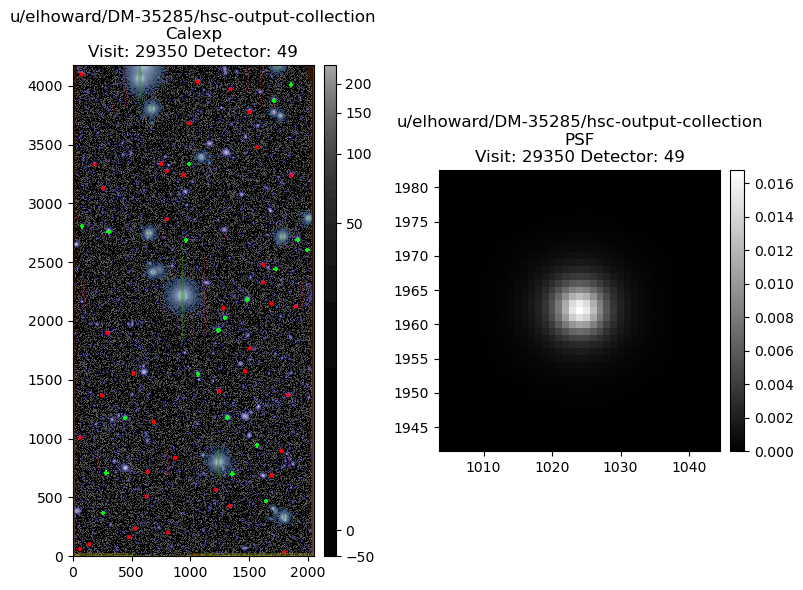

Collection:  u/smart/DM-36389/hsc-output-collection , Visit:  29350 , Detector:  49
Accepted PSF Sources (green):  40  Rejected PSF Sources (red):  20


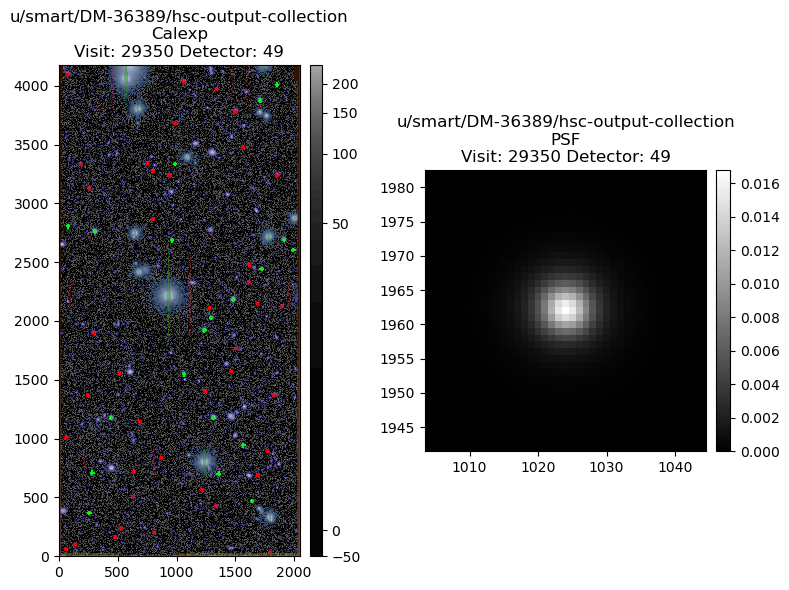

In [43]:
for collection in collectionsList:
    for visit in visits:
        for detector in detectors:
            print('Collection: ', collection,
                  ', Visit: ', calexp.visitInfo.getId(),
                  ', Detector: ', calexp.detector.getId())
            
            afwDisplay.setDefaultBackend('matplotlib') 
            fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(8, 6))
            
            plt.sca(ax1)  # set the first axis as current
            calexp = butler.get('calexp', instrument=instrument,
                                visit=visit, detector=detector, collections=collection)
            display1 = afwDisplay.Display(frame=fig)
            display1.setMaskTransparency(80)
            display1.scale('asinh', -1, 30)
            display1.mtv(calexp, f'{collection}\nCalexp\nVisit: {visit} Detector: {detector}')
            src = butler.get('src', instrument=instrument,
                             visit=visit, detector=detector, collections=collection)
            acceptedPsfSources = src[src['calib_psf_used']]
            rejectedPsfSources = src[src['calib_psf_candidate'] &
                                 (src['calib_psf_used'] == False)]
            print('Accepted PSF Sources (green): ', len(acceptedPsfSources),
                  ' Rejected PSF Sources (red): ', len(rejectedPsfSources))
            with display1.Buffering():
                for s in src[src['calib_psf_used']]:
                    display1.dot("x", s.getX(), s.getY(), size=10, ctype='red')
            with display1.Buffering():
                for s in rejectedPsfSources:
                    display1.dot("+", s.getX(), s.getY(), size=10, ctype='green')

            plt.sca(ax2)  # set the second axis as current
            psf = calexp.getPsf()
            position = psf.getAveragePosition()
            display2 = afwDisplay.Display(frame=fig)
            display2.mtv(psf.computeImage(position), f'{collection}\nPSF\nVisit: {visit} Detector: {detector}')
            
            plt.tight_layout()
            plt.show()
            plt.close(fig)

## 7. SNR distributions

SNR distribution is consistent with previous run. Still have some outliers.

In [44]:
%matplotlib widget

(0.0, 10000.0)

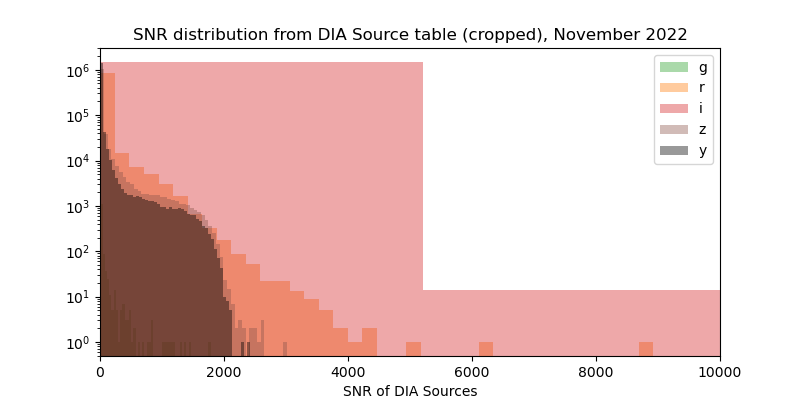

In [45]:
plt.figure(figsize=(8,4))
plt.yscale('log')
for band, color in zip(bandList, colorList):
    snrHist = plt.hist(srcTable.loc[srcTable.filterName==band, 'snr'], bins=50, color=color, alpha=0.4, label=band)
plt.legend()
plt.title(f'SNR distribution from DIA Source table (cropped), {month} {year}')
plt.xlabel('SNR of DIA Sources')
plt.gca().set_xlim(0, 10000)

Text(0.5, 0, 'SNR of DIA Sources')

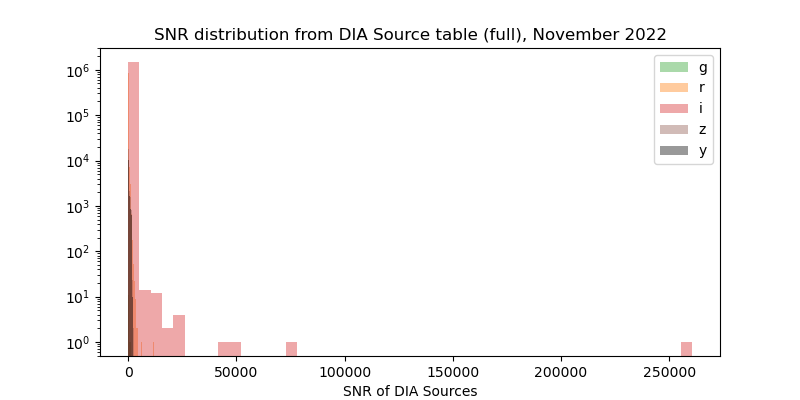

In [46]:
plt.figure(figsize=(8,4))
plt.yscale('log')
for band, color in zip(bandList, colorList):
    snrHist = plt.hist(srcTable.loc[srcTable.filterName==band, 'snr'], bins=50, color=color, alpha=0.4, label=band)
plt.legend()
plt.title(f'SNR distribution from DIA Source table (full), {month} {year}')
plt.xlabel('SNR of DIA Sources')

In [47]:
# Pre-snr column:
srcTable['psFluxSNR'] = srcTable.psFlux / srcTable.psFluxErr
srcTable['totFluxSNR'] = srcTable.totFlux / srcTable.totFluxErr

Text(0.5, 0, 'psFlux/psFluxErr')

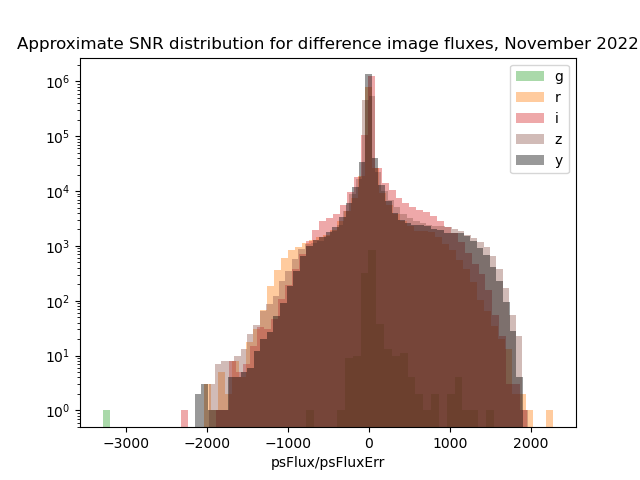

In [48]:
plt.figure()
plt.yscale('log')
for band, color in zip(bandList, colorList):
    psFluxHist = plt.hist(srcTable.loc[srcTable.filterName==band, 'psFluxSNR'], bins=50, color=color, alpha=0.4, label=band)
plt.legend()
plt.title(f'Approximate SNR distribution for difference image fluxes, {month} {year}')
plt.xlabel('psFlux/psFluxErr')

Text(0.5, 0, 'totFlux/totFluxErr')

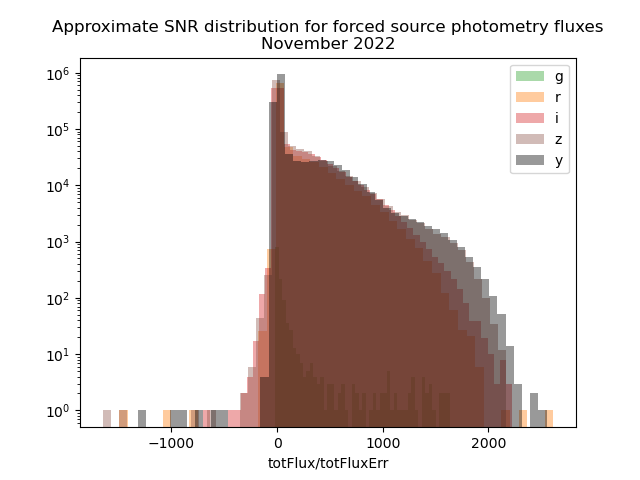

In [49]:
plt.figure()
plt.yscale('log')
for band, color in zip(bandList, colorList):
    totFluxHist = plt.hist(srcTable.loc[srcTable.filterName==band, 'totFluxSNR'], bins=50, color=color, alpha=0.4, label=band)
plt.legend()
plt.title(f'Approximate SNR distribution for forced source photometry fluxes\n{month} {year}')
plt.xlabel('totFlux/totFluxErr')